### denoising-dirty-documents

In [ ]:
import torch
from torch import nn
import torchvision 
import os
from torchvision import transforms as T
from torchvision.io import read_image
from torch.utils.data import Dataset, random_split
import matplotlib.pyplot as plt
from torchsummary import summary
import numpy as np
from torchvision.io import read_image, write_jpeg
import pandas as pd

In [ ]:
! pip install kaggle
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
! kaggle competitions download -c denoising-dirty-documents

 98% 35.0M/35.7M [00:02<00:00, 22.9MB/s]
100% 35.7M/35.7M [00:02<00:00, 13.3MB/s]


In [ ]:
! unzip denoising-dirty-documents

Archive:  denoising-dirty-documents.zip
  inflating: sampleSubmission.csv.zip  
  inflating: test.zip                
  inflating: train.zip               
  inflating: train_cleaned.zip       


In [ ]:
! unzip -qq train_cleaned.zip

In [ ]:
! unzip -qq train.zip

In [ ]:
! unzip -qq test.zip

In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(device)

cuda:0


In [ ]:
class CustomImageDataset(Dataset):
    def __init__(self, noise_dir, clean_dir):
        self.noise_dir = noise_dir
        self.clean_dir = clean_dir
        self.noise_names = sorted(os.listdir(noise_dir))
        self.clean_names = sorted(os.listdir(clean_dir))
        self.preprocessing = T.Compose( [T.ToPILImage(),
                                         T.Resize((400, 500)),
                                         T.ToTensor()]
)
    def __len__(self):
        return len(self.noise_names)


    def __getitem__(self, idx):
        noisy_img = self.preprocessing(read_image(os.path.join(self.noise_dir, self.noise_names[idx]))/255)
        clean_img = self.preprocessing(read_image(os.path.join(self.clean_dir, self.clean_names[idx]))/255)
        return noisy_img, clean_img

In [ ]:
dataset = CustomImageDataset('train', 'train_cleaned')
train_data = torch.utils.data.DataLoader(dataset, batch_size=16, shuffle=True)

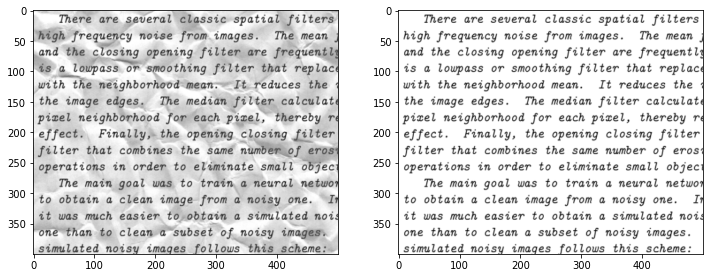

In [ ]:
f, axes = plt.subplots(1, 2, figsize=(12, 7))
data = next(iter(train_data))
axes[0].imshow(data[0][6].squeeze(0), cmap='gray')
axes[1].imshow(data[1][6].squeeze(0), cmap='gray')

In [ ]:
next(iter(train_data))[0].shape

torch.Size([16, 1, 400, 500])

In [ ]:
class ConvAutoencoder(nn.Module):
    def __init__(self) -> None:
        super().__init__()
        
        # encoder
        self.conv1 = nn.Sequential(nn.Conv2d(1, 32, kernel_size=3),
                                   nn.LeakyReLU(),
                                   nn.BatchNorm2d(32))
        self.conv2 = nn.Sequential(nn.Conv2d(32, 64, kernel_size=3),
                                   nn.LeakyReLU(),
                                   nn.BatchNorm2d(64))
        self.conv3 = nn.Sequential(nn.Conv2d(64, 64, kernel_size=3),
                                   nn.LeakyReLU(),
                                   nn.BatchNorm2d(64))
        self.pool = nn.MaxPool2d(2, return_indices=True)
        
        # decoder
        
        self.unpool = nn.MaxUnpool2d(2)
        
        self.conv1_t = nn.Sequential(nn.ConvTranspose2d(64, 64, kernel_size=3),
                                     nn.LeakyReLU(),
                                     nn.BatchNorm2d(64))
        self.conv2_t = nn.Sequential(nn.ConvTranspose2d(64, 32, kernel_size=3),
                                     nn.LeakyReLU(),
                                     nn.BatchNorm2d(32))
        self.conv3_t = nn.Sequential(nn.ConvTranspose2d(32, 1, kernel_size=3),
                                     nn.LeakyReLU(),
                                     nn.BatchNorm2d(1))
        
    def encoder(self, x):
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
            
        x, indices = self.pool(x)
        return x, indices
        
        
    def decoder(self, x, indices):
        x = self.unpool(x, indices)
        x = self.conv1_t(x)
        x = self.conv2_t(x)
        x = self.conv3_t(x)
        return x
        
        
    def forward(self, x):
        latent, indices = self.encoder(x)
        result = self.decoder(latent, indices)
        return result

In [ ]:
model = ConvAutoencoder()
summary(model.to(device), (1, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 254, 254]             320
         LeakyReLU-2         [-1, 32, 254, 254]               0
       BatchNorm2d-3         [-1, 32, 254, 254]              64
            Conv2d-4         [-1, 64, 252, 252]          18,496
         LeakyReLU-5         [-1, 64, 252, 252]               0
       BatchNorm2d-6         [-1, 64, 252, 252]             128
            Conv2d-7         [-1, 64, 250, 250]          36,928
         LeakyReLU-8         [-1, 64, 250, 250]               0
       BatchNorm2d-9         [-1, 64, 250, 250]             128
        MaxPool2d-10  [[-1, 64, 125, 125], [-1, 64, 125, 125]]               0
      MaxUnpool2d-11         [-1, 64, 250, 250]               0
  ConvTranspose2d-12         [-1, 64, 252, 252]          36,928
        LeakyReLU-13         [-1, 64, 252, 252]               0
      BatchNorm2d-14    

In [ ]:
def autoencoder_training(model, n_epochs, optimizer, criterion):
    
    history = {'train_loss': [],
               'train_metric': []}
    
    model.to(device)
    metrics = nn.L1Loss()
    
    for epoch in range(1, n_epochs+1):
        
        model.train()
        train_loss_batch = []
        train_metric_batch = []
        
        for images, cleaned_imges in train_data:
            images = images.to(device)
            cleaned_imges = cleaned_imges.to(device)
            
            outputs = model(images)
            loss = criterion(outputs, cleaned_imges)
            train_loss_batch.append(loss.item())
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            train_metric_batch.append(metrics(outputs, cleaned_imges).item())
            
        history['train_loss'].append(np.mean(train_loss_batch))
        history['train_metric'].append(np.mean(train_metric_batch))
        
        noisy_sample = images[0]
        clean_sample = cleaned_imges[0]
        
        if epoch % 1 == 0:
            print(f'Epoch: {epoch} \tTraining Loss: {round(history["train_loss"][-1], 4)} \tmetric:{round(history["train_metric"][-1], 4)}')

            fig, ax = plt.subplots(1, 3, figsize=(16, 8))
            ax[0].imshow(noisy_sample.detach().cpu().numpy()[0], cmap='gray')
            ax[1].imshow(outputs.detach().cpu().numpy()[0][0], cmap='gray')
            ax[2].imshow(clean_sample.detach().cpu().numpy()[0], cmap='gray')
            plt.show()

    
    return history

Epoch: 1 	Training Loss: 1.6051 	metric:1.04


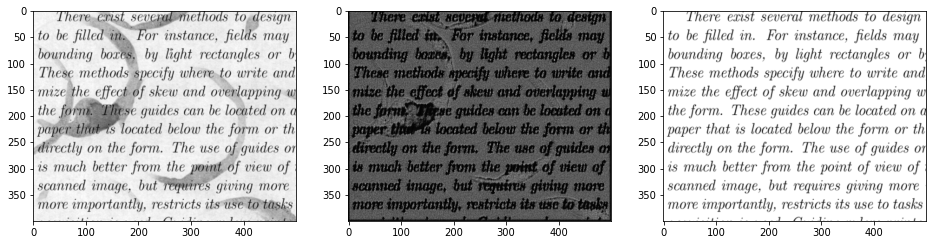

Epoch: 2 	Training Loss: 1.463 	metric:0.9238


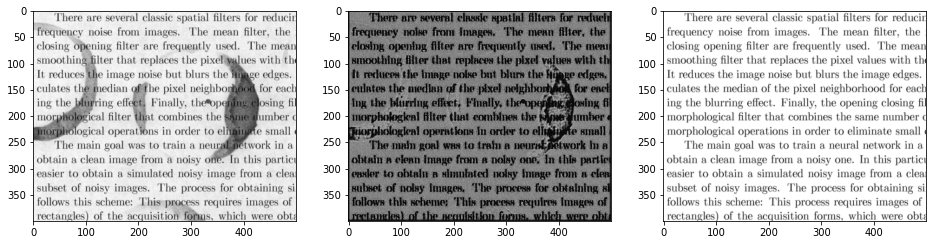

Epoch: 3 	Training Loss: 1.4018 	metric:0.8934


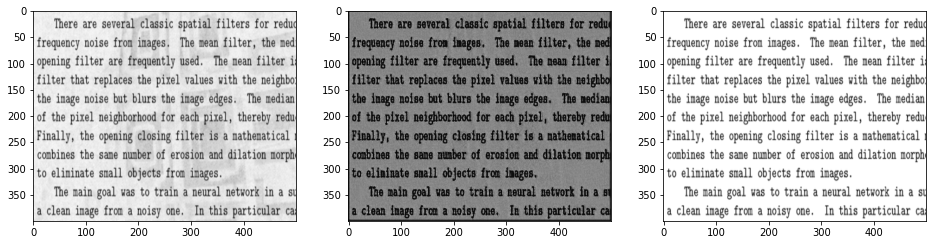

Epoch: 4 	Training Loss: 1.3569 	metric:0.8753


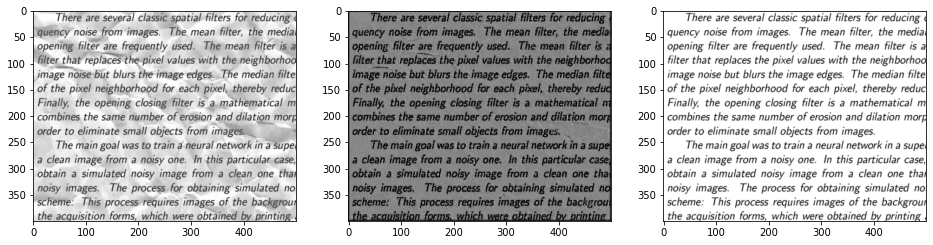

Epoch: 5 	Training Loss: 1.3199 	metric:0.8604


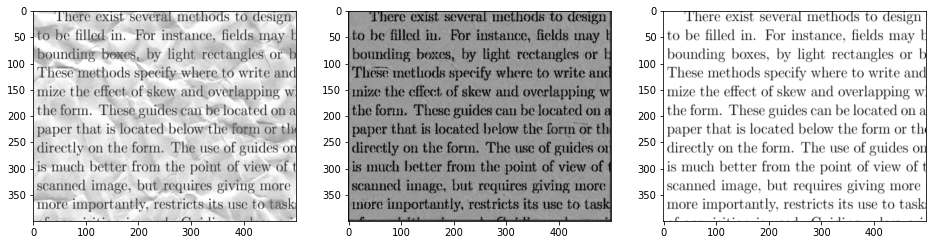

Epoch: 6 	Training Loss: 1.2868 	metric:0.8505


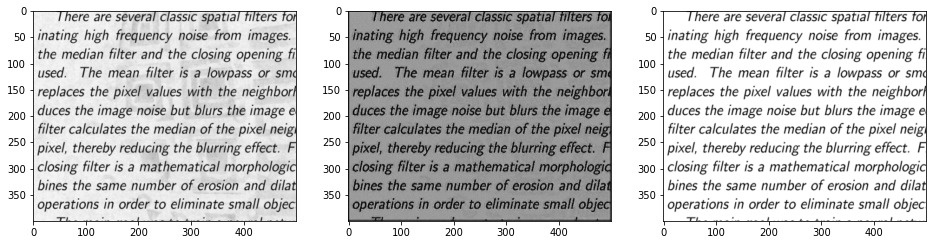

Epoch: 7 	Training Loss: 1.2561 	metric:0.8409


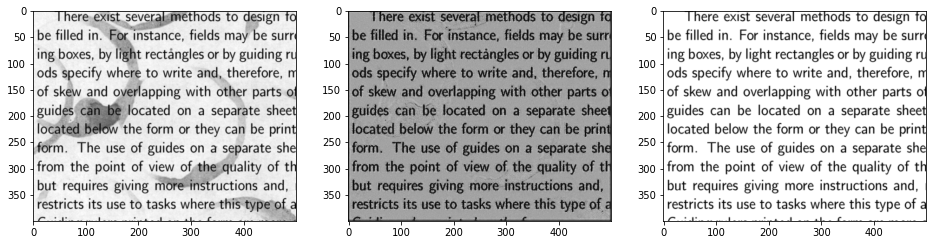

Epoch: 8 	Training Loss: 1.2271 	metric:0.8321


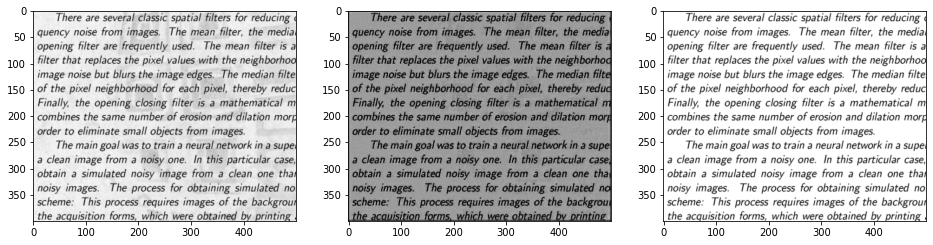

Epoch: 9 	Training Loss: 1.1989 	metric:0.8239


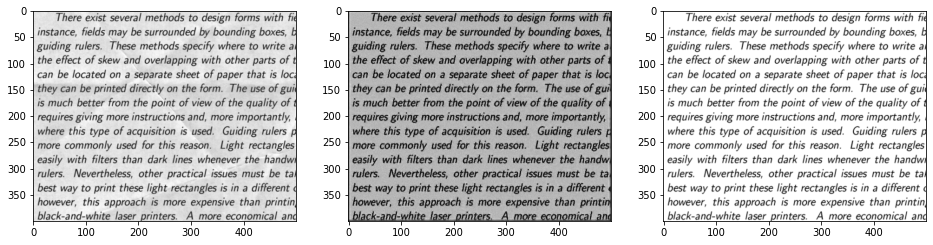

Epoch: 10 	Training Loss: 1.1721 	metric:0.8157


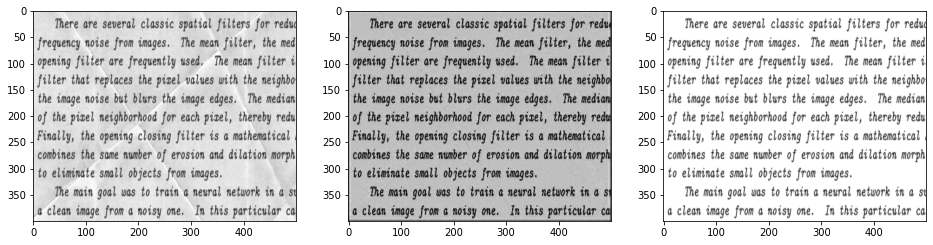

Epoch: 11 	Training Loss: 1.1463 	metric:0.8079


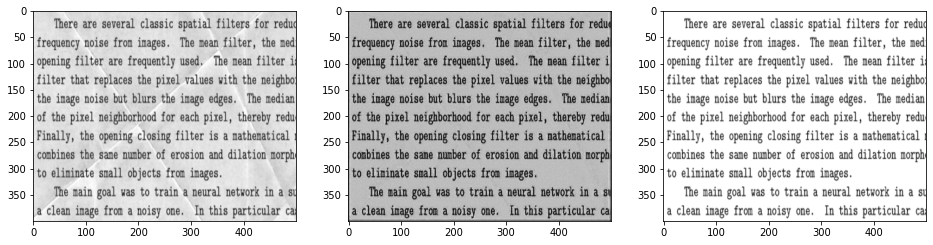

Epoch: 12 	Training Loss: 1.1212 	metric:0.7999


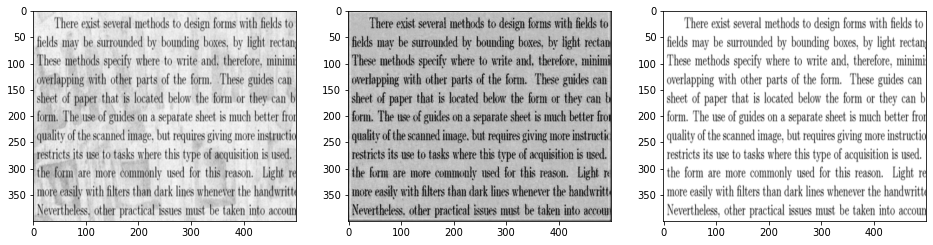

Epoch: 13 	Training Loss: 1.0962 	metric:0.792


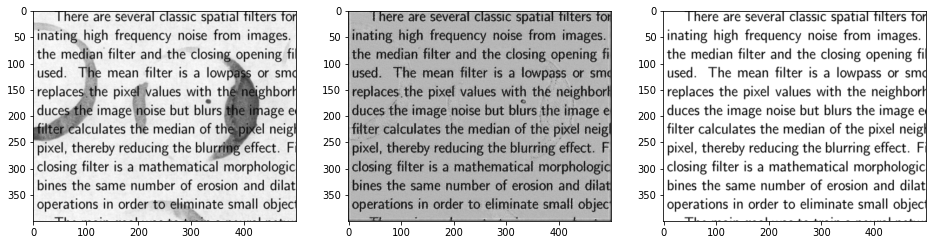

Epoch: 14 	Training Loss: 1.0726 	metric:0.7842


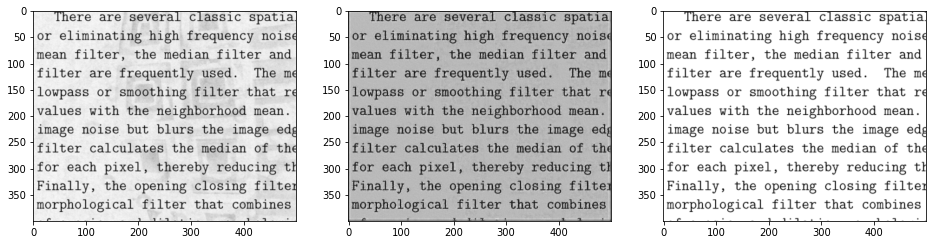

Epoch: 15 	Training Loss: 1.0494 	metric:0.7765


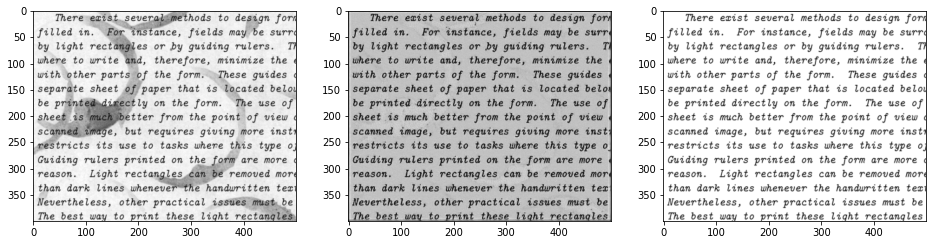

Epoch: 16 	Training Loss: 1.0265 	metric:0.7687


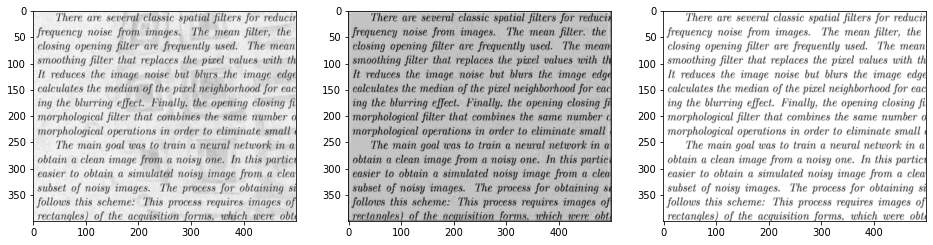

Epoch: 17 	Training Loss: 1.0045 	metric:0.7612


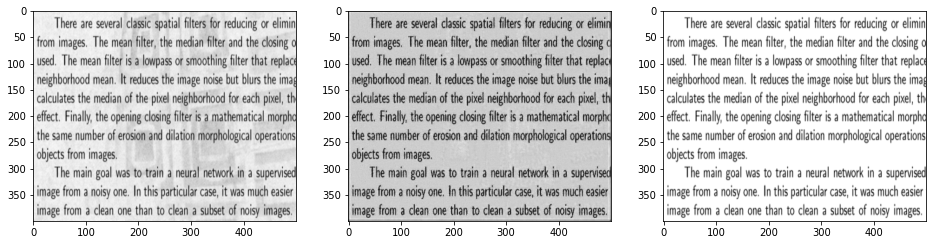

Epoch: 18 	Training Loss: 0.9828 	metric:0.7537


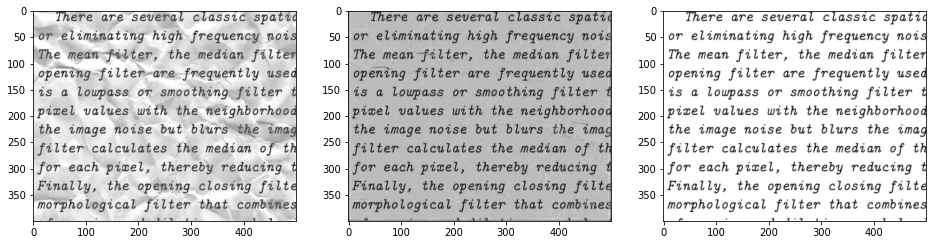

Epoch: 19 	Training Loss: 0.9618 	metric:0.7459


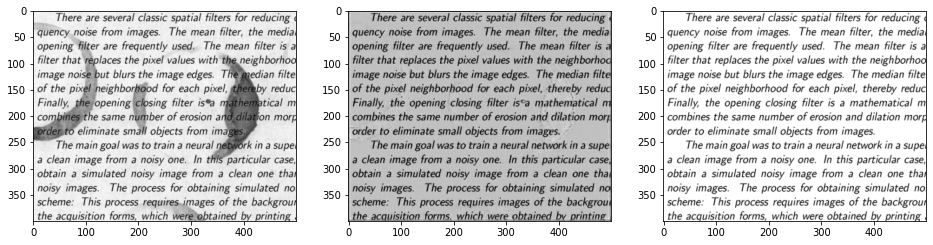

Epoch: 20 	Training Loss: 0.9407 	metric:0.7384


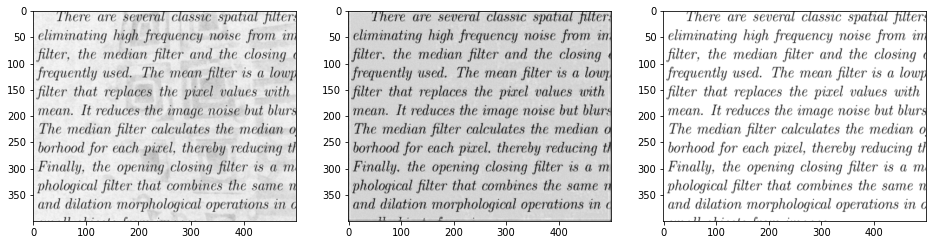

Epoch: 21 	Training Loss: 0.9201 	metric:0.731


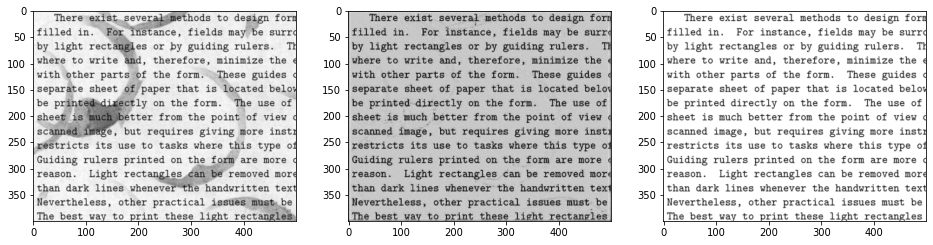

Epoch: 22 	Training Loss: 0.9003 	metric:0.7235


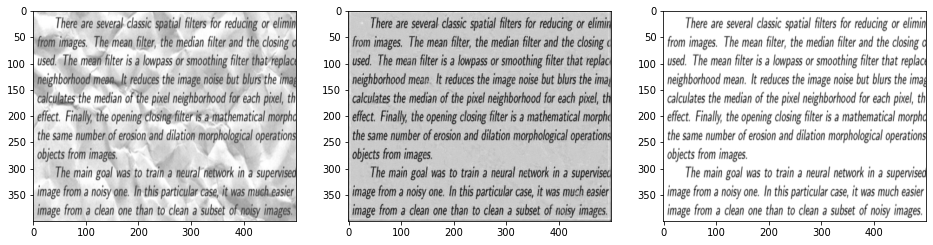

Epoch: 23 	Training Loss: 0.8805 	metric:0.7161


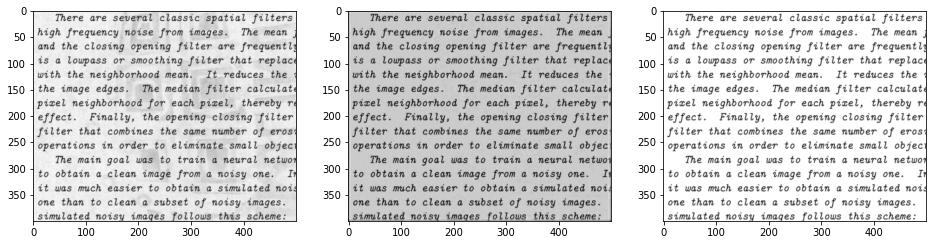

Epoch: 24 	Training Loss: 0.8612 	metric:0.7088


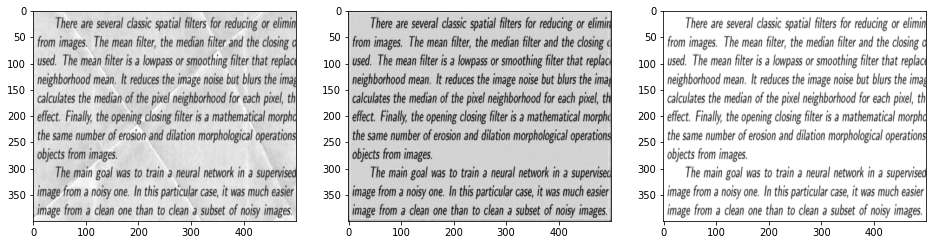

Epoch: 25 	Training Loss: 0.842 	metric:0.7015


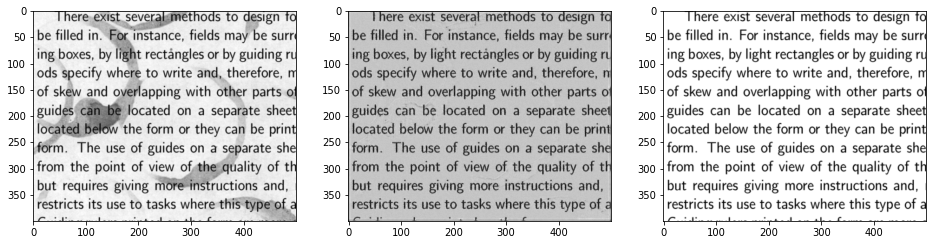

Epoch: 26 	Training Loss: 0.8238 	metric:0.6943


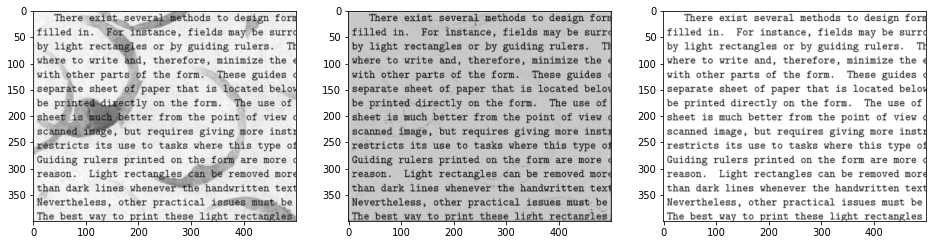

Epoch: 27 	Training Loss: 0.8055 	metric:0.687


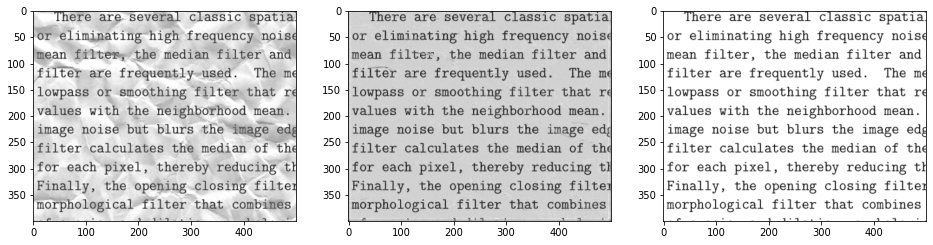

Epoch: 28 	Training Loss: 0.7872 	metric:0.6799


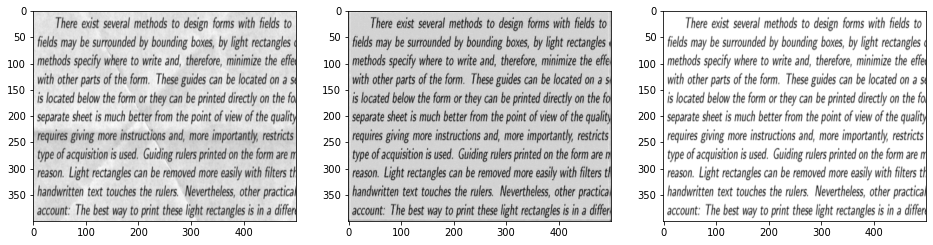

Epoch: 29 	Training Loss: 0.7695 	metric:0.6727


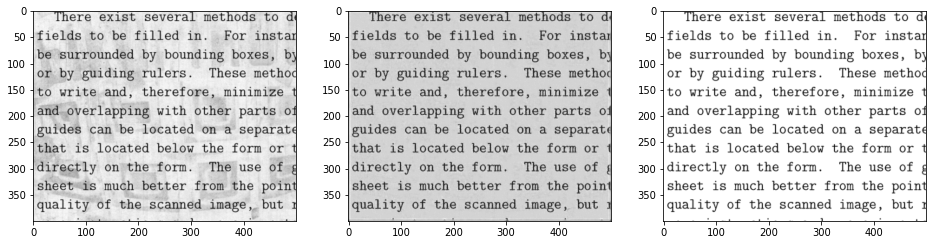

Epoch: 30 	Training Loss: 0.7522 	metric:0.6656


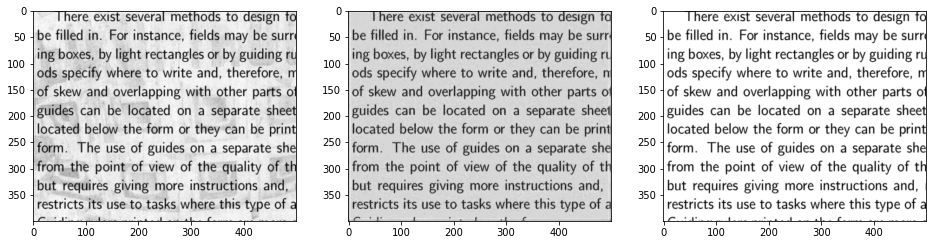

Epoch: 31 	Training Loss: 0.7356 	metric:0.6586


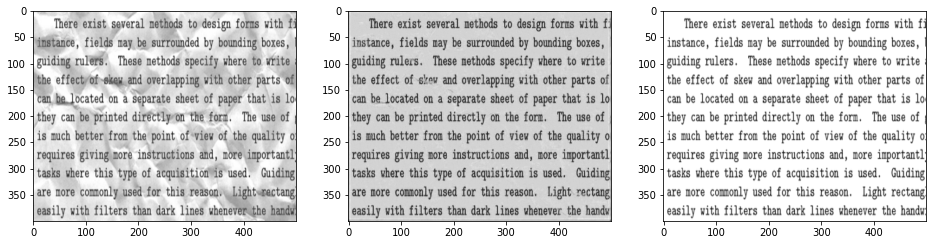

Epoch: 32 	Training Loss: 0.7187 	metric:0.6516


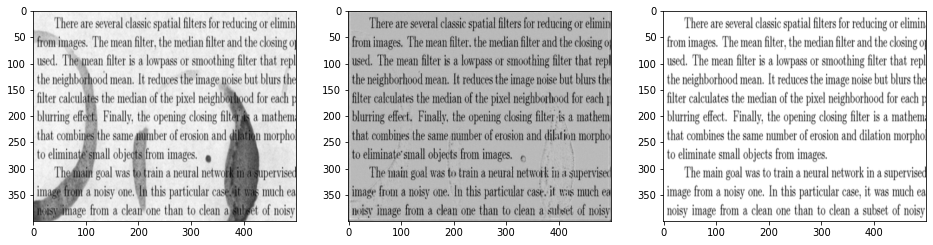

Epoch: 33 	Training Loss: 0.7023 	metric:0.6446


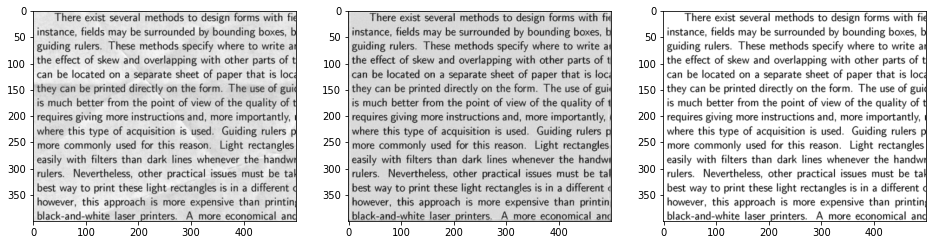

Epoch: 34 	Training Loss: 0.6863 	metric:0.6377


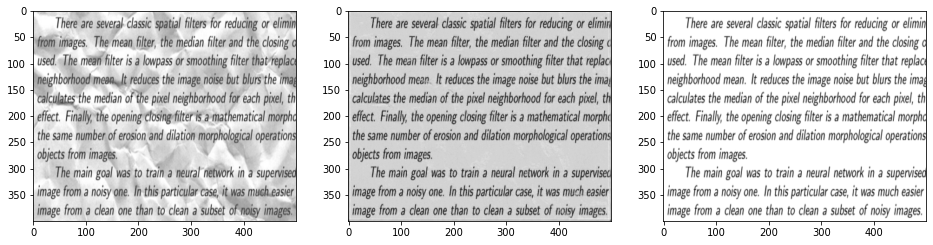

Epoch: 35 	Training Loss: 0.6705 	metric:0.6308


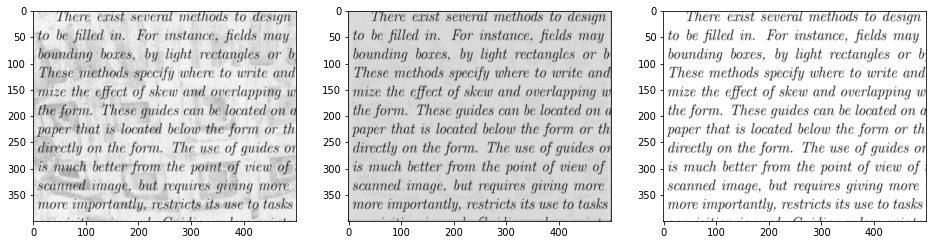

Epoch: 36 	Training Loss: 0.6549 	metric:0.6239


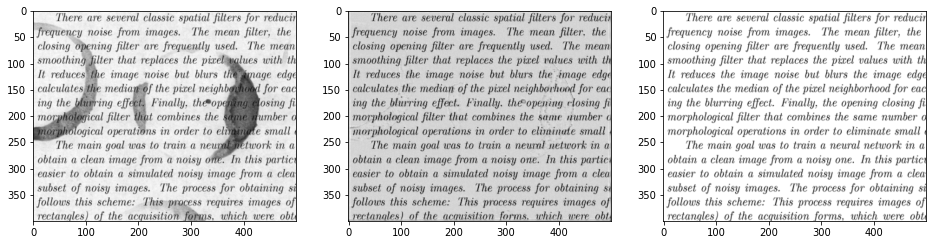

Epoch: 37 	Training Loss: 0.6399 	metric:0.6171


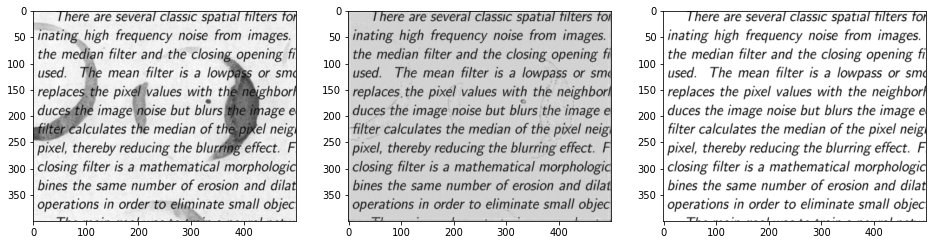

Epoch: 38 	Training Loss: 0.6247 	metric:0.6104


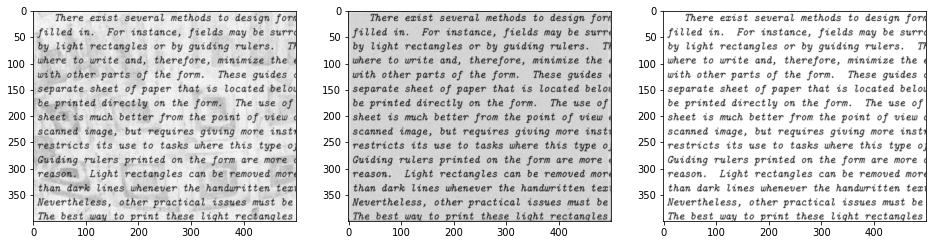

Epoch: 39 	Training Loss: 0.6102 	metric:0.6037


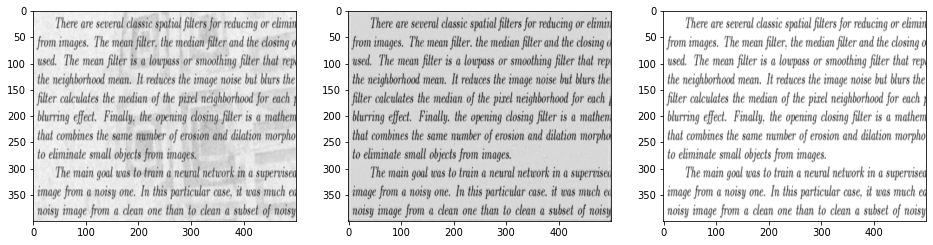

Epoch: 40 	Training Loss: 0.5957 	metric:0.597


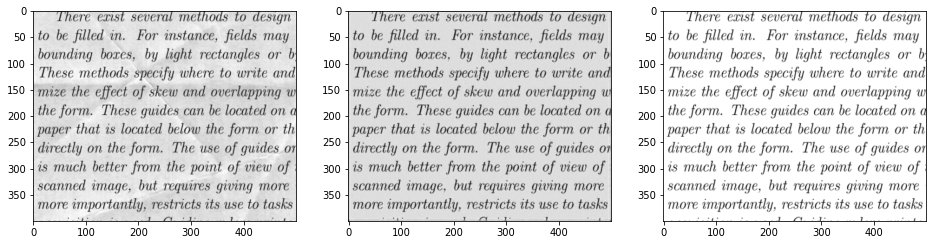

Epoch: 41 	Training Loss: 0.5818 	metric:0.5903


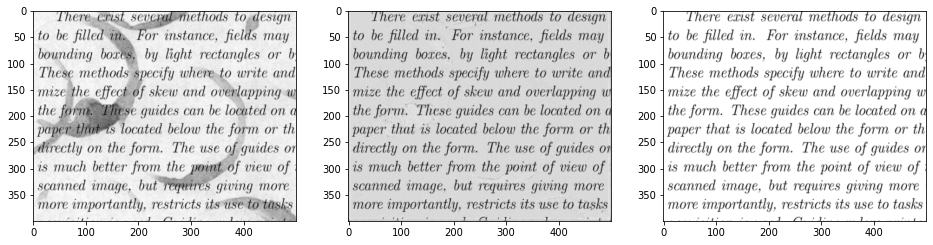

Epoch: 42 	Training Loss: 0.5679 	metric:0.5837


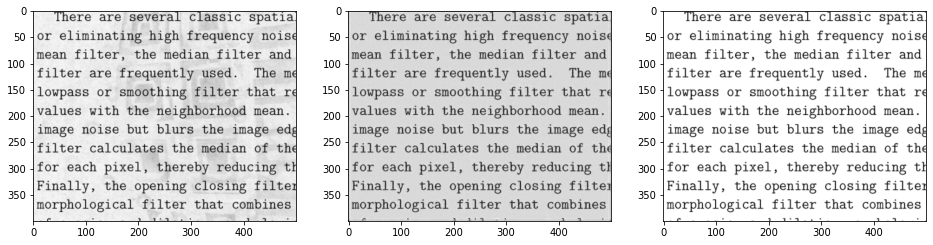

Epoch: 43 	Training Loss: 0.5543 	metric:0.5772


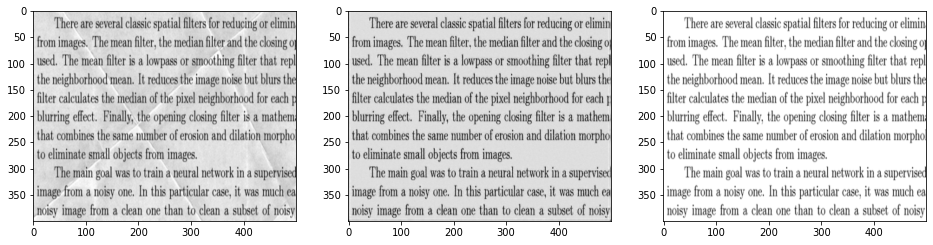

Epoch: 44 	Training Loss: 0.5411 	metric:0.5706


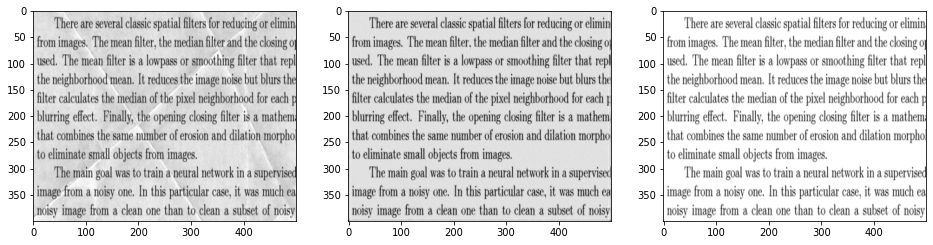

Epoch: 45 	Training Loss: 0.5281 	metric:0.5642


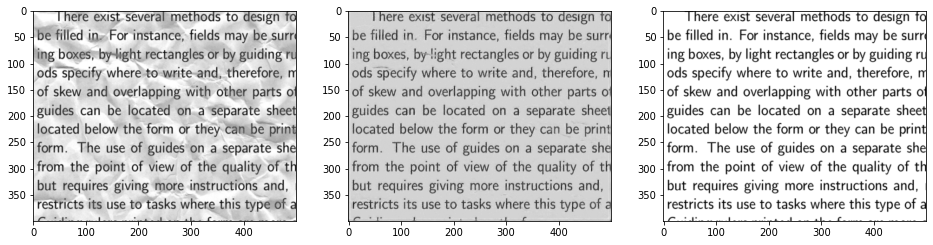

Epoch: 46 	Training Loss: 0.5151 	metric:0.5577


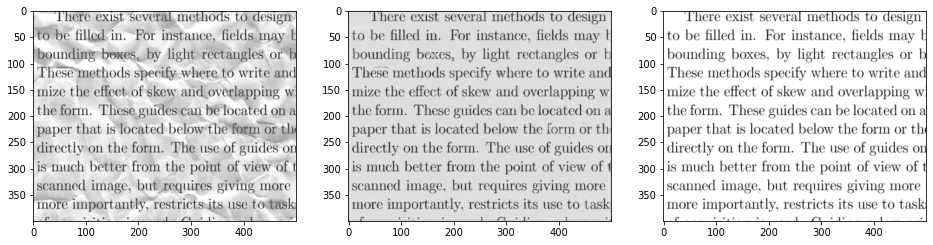

Epoch: 47 	Training Loss: 0.5024 	metric:0.5513


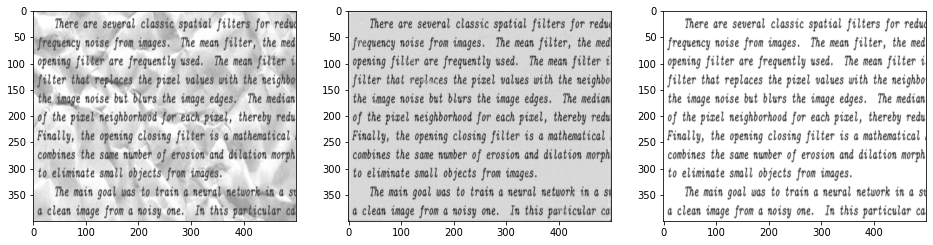

Epoch: 48 	Training Loss: 0.49 	metric:0.545


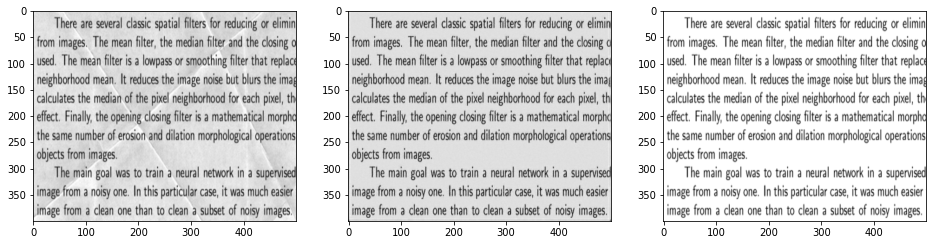

Epoch: 49 	Training Loss: 0.478 	metric:0.5386


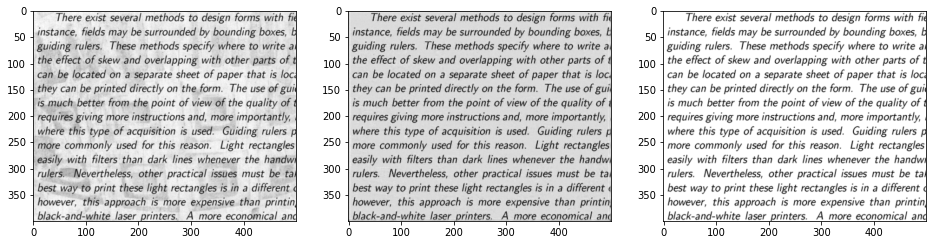

Epoch: 50 	Training Loss: 0.4662 	metric:0.5324


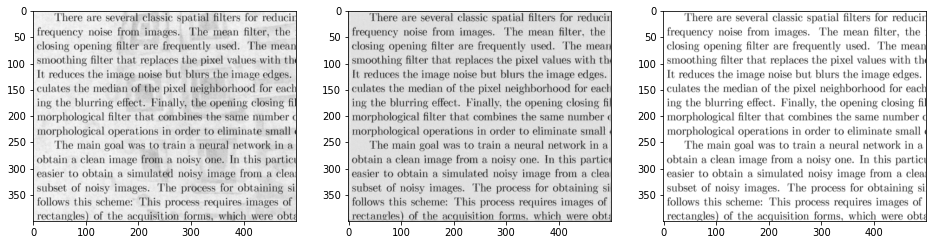

Epoch: 51 	Training Loss: 0.4547 	metric:0.5261


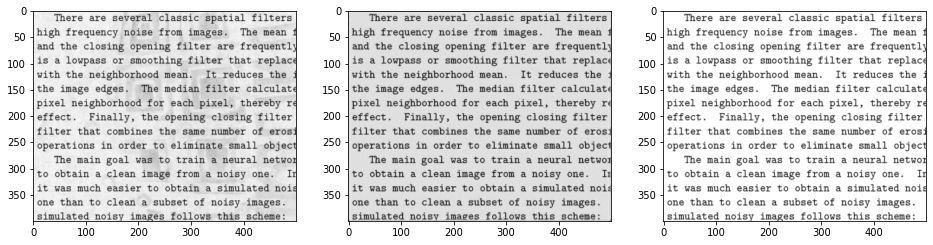

Epoch: 52 	Training Loss: 0.4433 	metric:0.5199


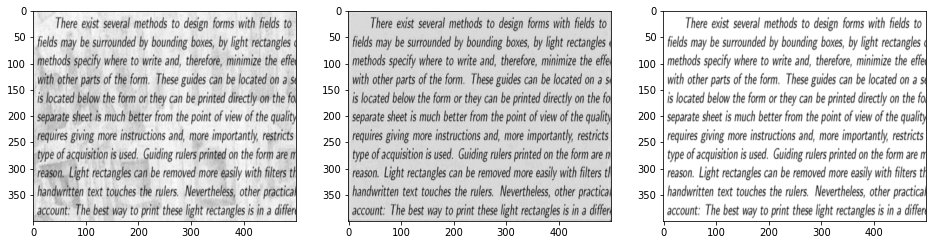

Epoch: 53 	Training Loss: 0.4323 	metric:0.5138


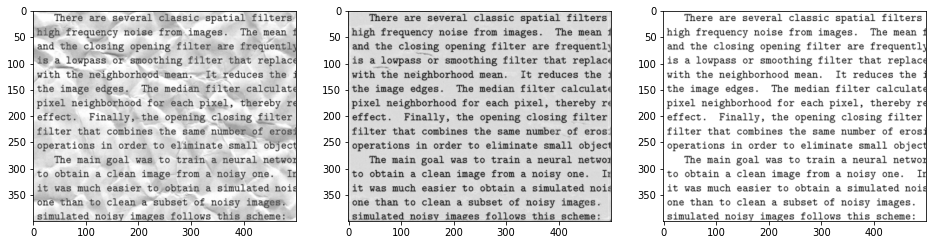

Epoch: 54 	Training Loss: 0.4212 	metric:0.5077


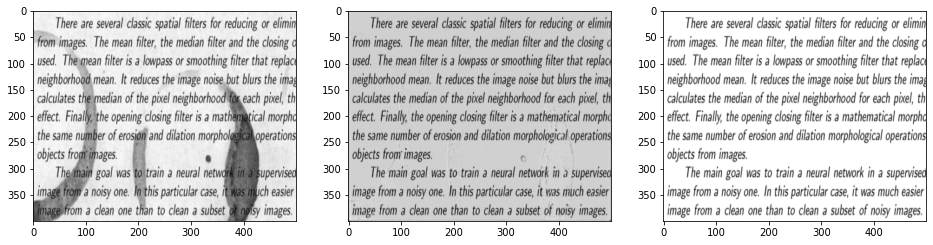

Epoch: 55 	Training Loss: 0.4106 	metric:0.5016


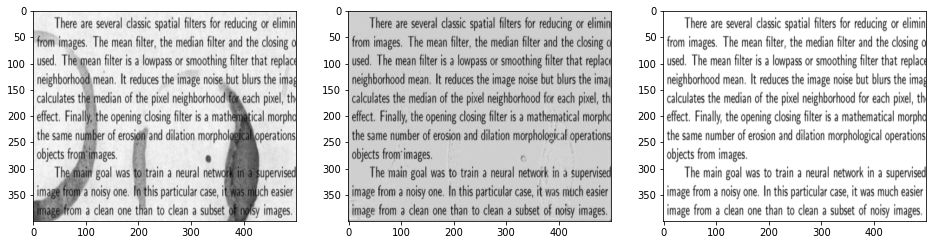

Epoch: 56 	Training Loss: 0.4 	metric:0.4955


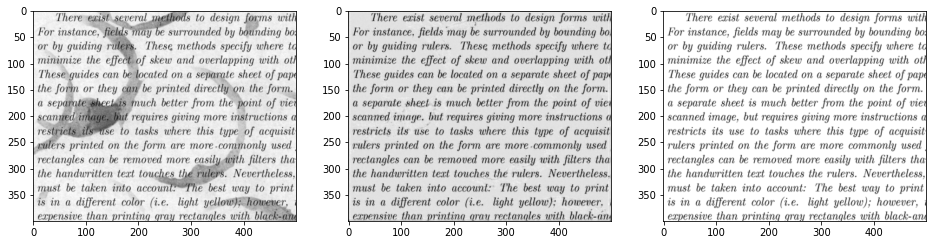

Epoch: 57 	Training Loss: 0.3897 	metric:0.4896


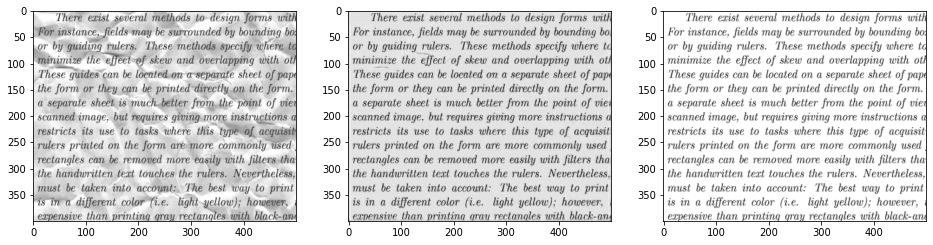

Epoch: 58 	Training Loss: 0.3797 	metric:0.4836


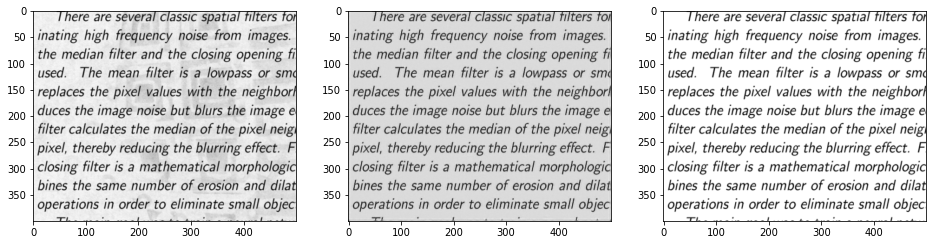

Epoch: 59 	Training Loss: 0.3699 	metric:0.4777


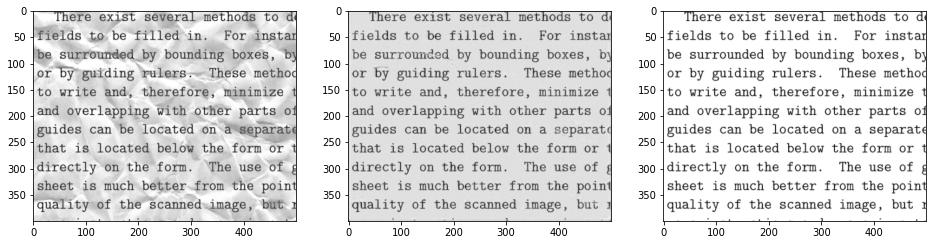

Epoch: 60 	Training Loss: 0.3602 	metric:0.4718


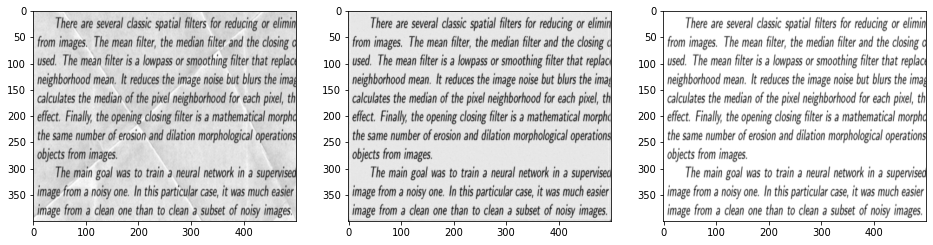

Epoch: 61 	Training Loss: 0.3505 	metric:0.466


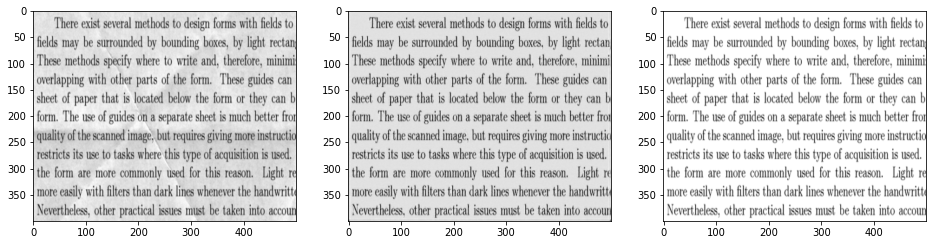

Epoch: 62 	Training Loss: 0.3414 	metric:0.4602


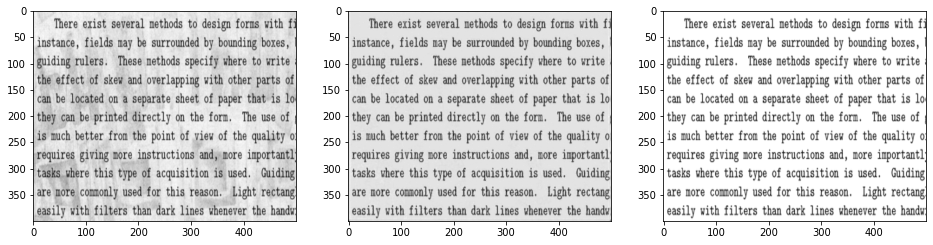

Epoch: 63 	Training Loss: 0.3323 	metric:0.4544


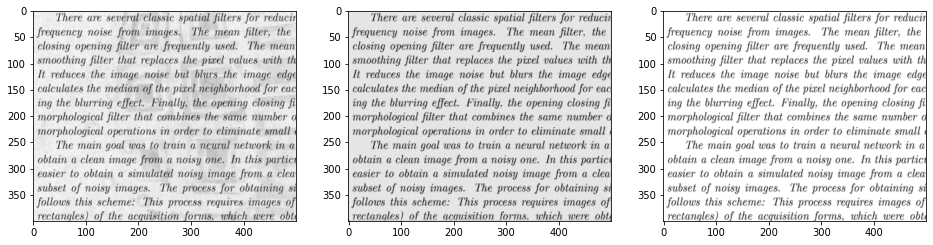

Epoch: 64 	Training Loss: 0.3234 	metric:0.4487


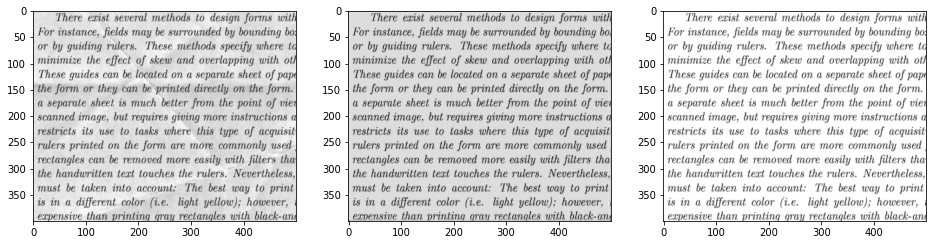

Epoch: 65 	Training Loss: 0.3146 	metric:0.4431


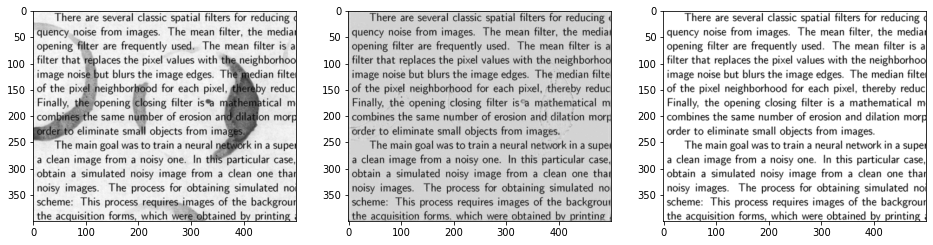

Epoch: 66 	Training Loss: 0.3061 	metric:0.4374


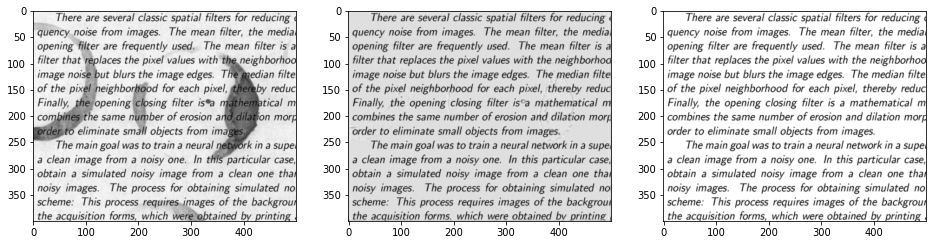

Epoch: 67 	Training Loss: 0.2977 	metric:0.4319


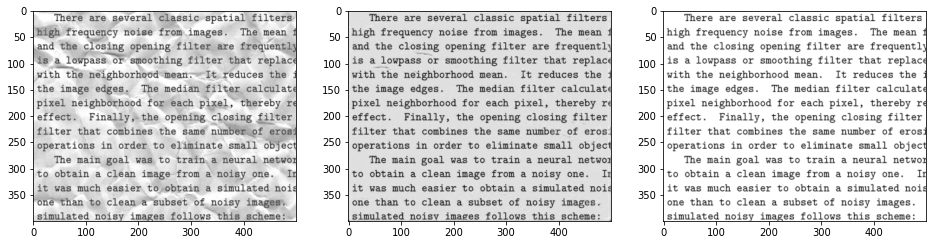

Epoch: 68 	Training Loss: 0.2896 	metric:0.4263


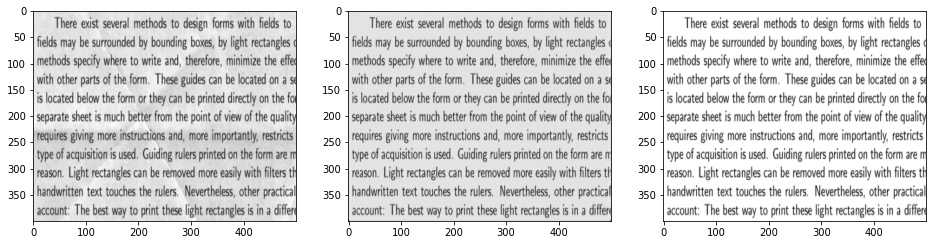

Epoch: 69 	Training Loss: 0.2816 	metric:0.4208


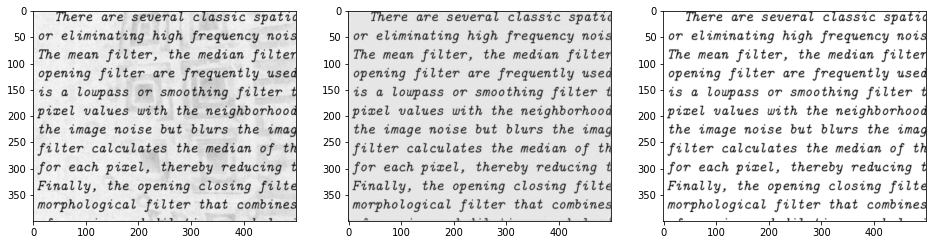

Epoch: 70 	Training Loss: 0.2739 	metric:0.4154


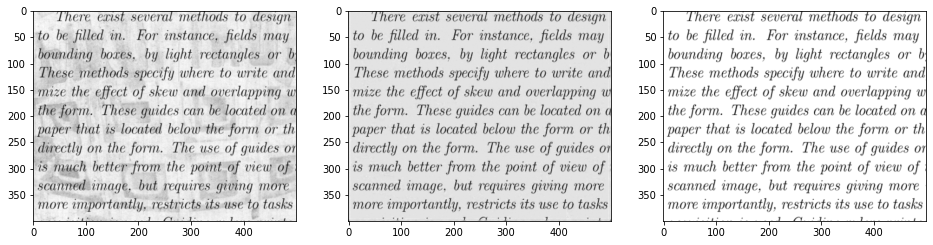

Epoch: 71 	Training Loss: 0.2662 	metric:0.4099


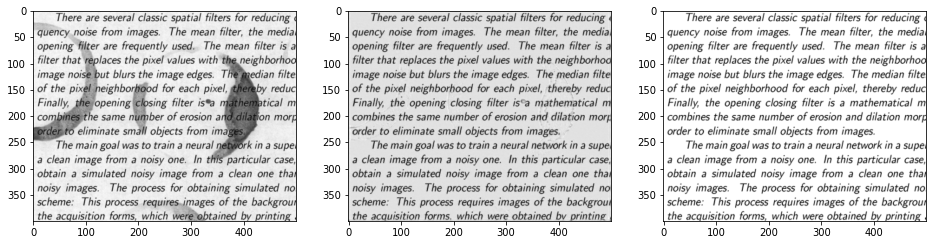

Epoch: 72 	Training Loss: 0.2589 	metric:0.4046


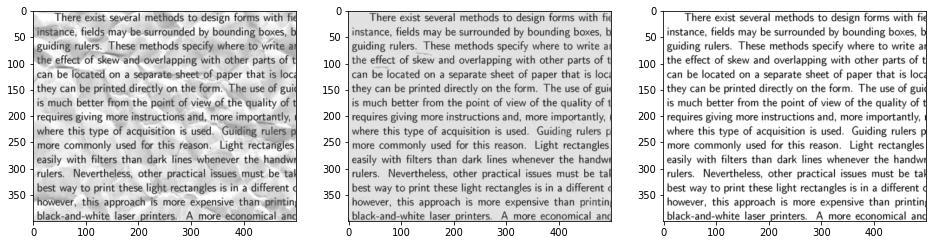

Epoch: 73 	Training Loss: 0.2518 	metric:0.3992


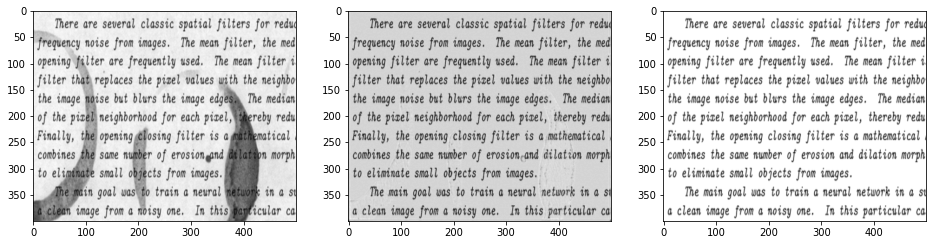

Epoch: 74 	Training Loss: 0.2446 	metric:0.3939


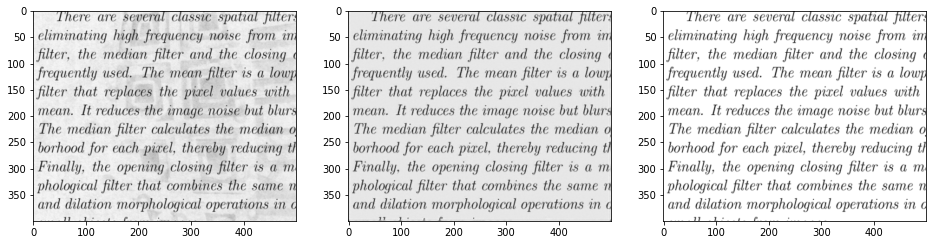

Epoch: 75 	Training Loss: 0.2377 	metric:0.3887


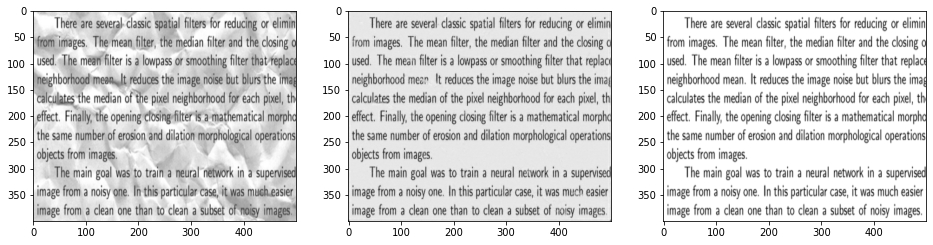

Epoch: 76 	Training Loss: 0.2308 	metric:0.3835


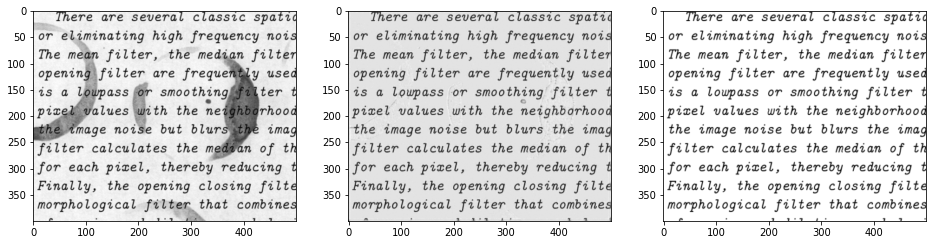

Epoch: 77 	Training Loss: 0.2242 	metric:0.3783


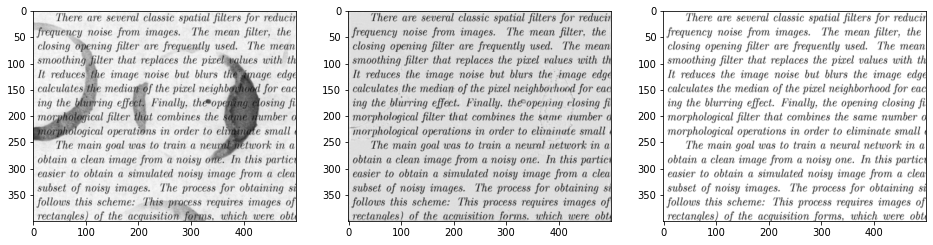

Epoch: 78 	Training Loss: 0.218 	metric:0.3732


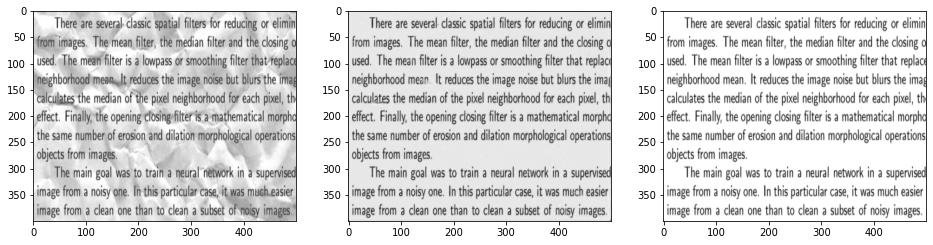

Epoch: 79 	Training Loss: 0.2115 	metric:0.3681


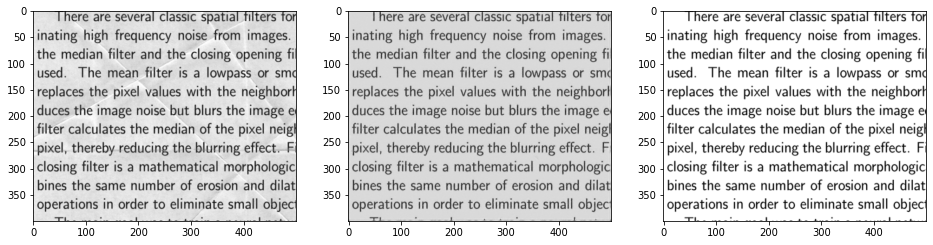

Epoch: 80 	Training Loss: 0.2054 	metric:0.363


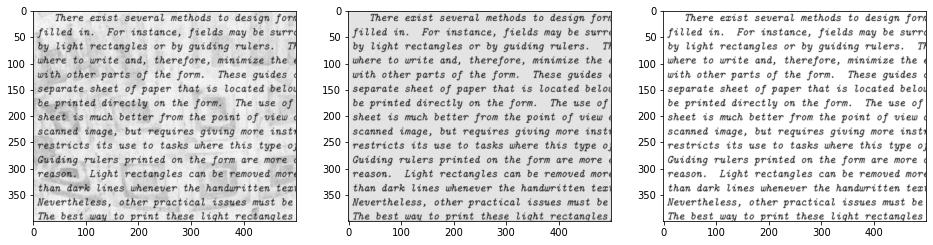

Epoch: 81 	Training Loss: 0.1994 	metric:0.358


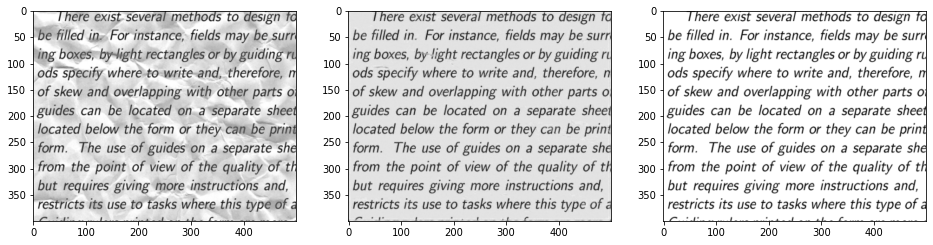

Epoch: 82 	Training Loss: 0.1936 	metric:0.3531


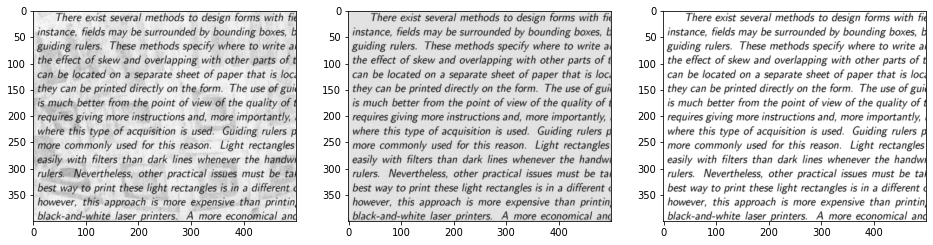

Epoch: 83 	Training Loss: 0.1878 	metric:0.3481


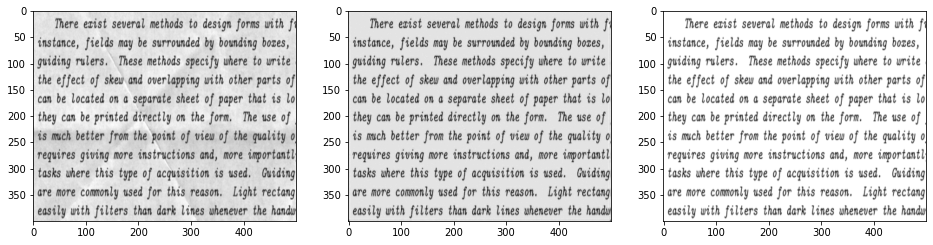

Epoch: 84 	Training Loss: 0.1822 	metric:0.3433


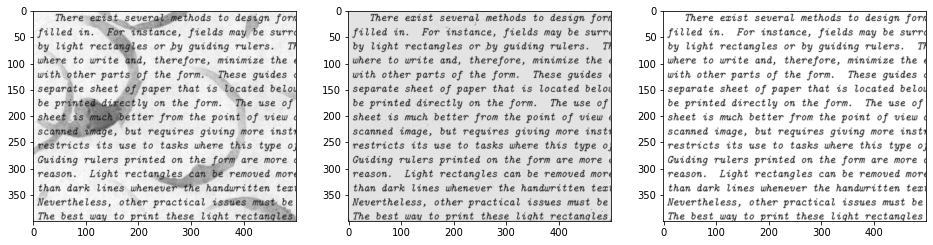

Epoch: 85 	Training Loss: 0.1768 	metric:0.3384


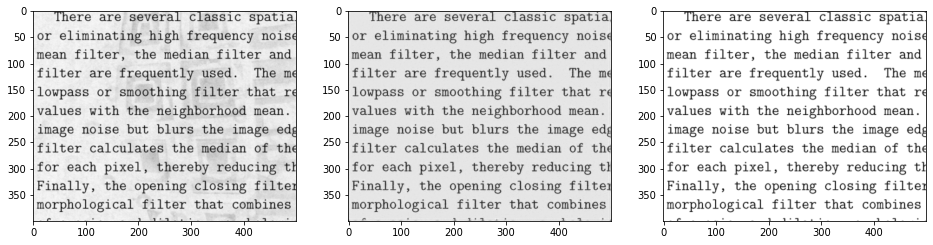

Epoch: 86 	Training Loss: 0.1715 	metric:0.3336


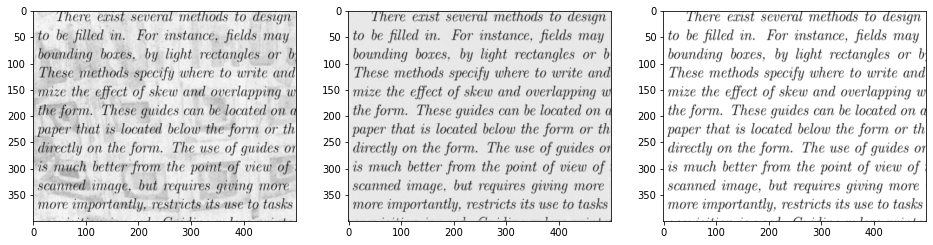

Epoch: 87 	Training Loss: 0.1662 	metric:0.3289


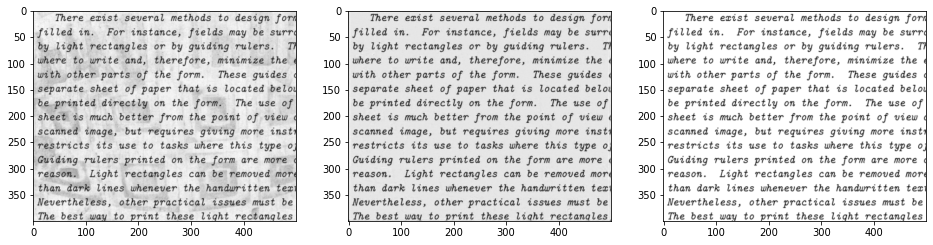

Epoch: 88 	Training Loss: 0.1612 	metric:0.3242


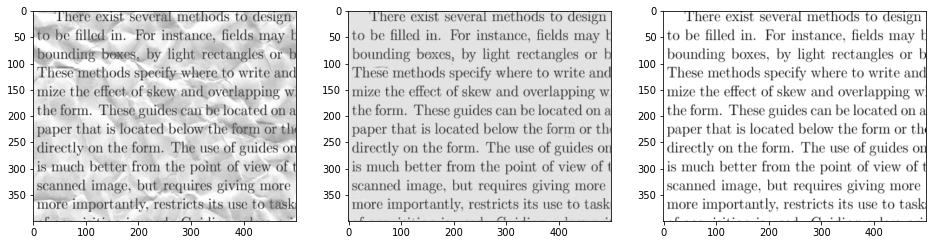

Epoch: 89 	Training Loss: 0.1563 	metric:0.3195


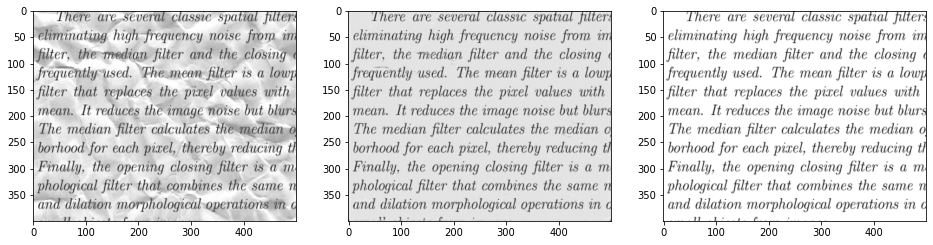

Epoch: 90 	Training Loss: 0.1515 	metric:0.3149


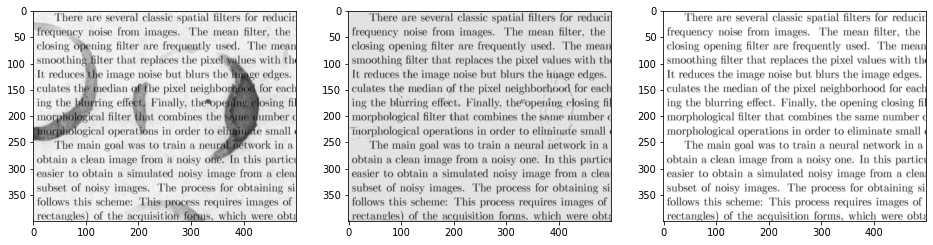

Epoch: 91 	Training Loss: 0.1468 	metric:0.3103


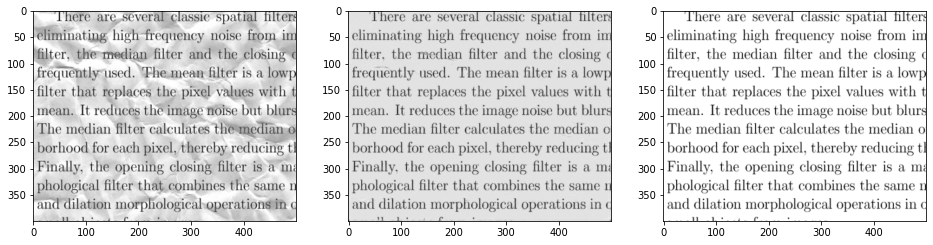

Epoch: 92 	Training Loss: 0.1422 	metric:0.3057


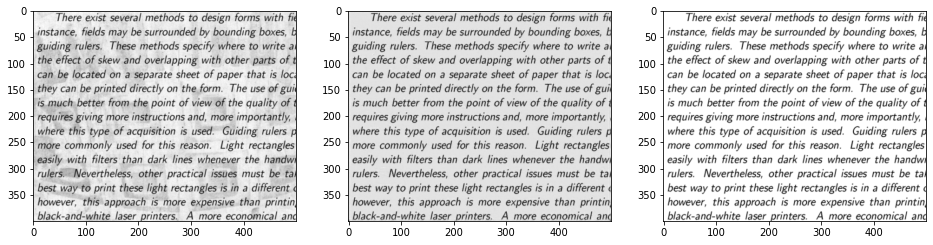

Epoch: 93 	Training Loss: 0.1378 	metric:0.3012


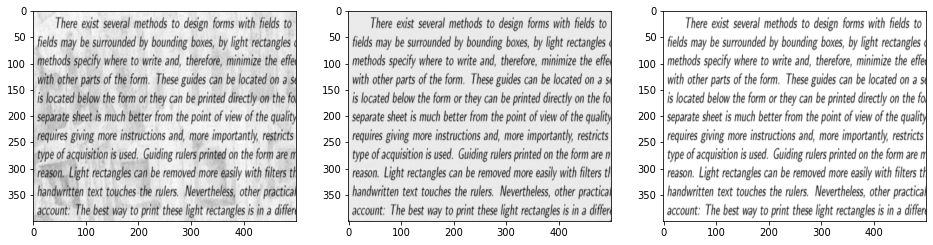

Epoch: 94 	Training Loss: 0.1334 	metric:0.2967


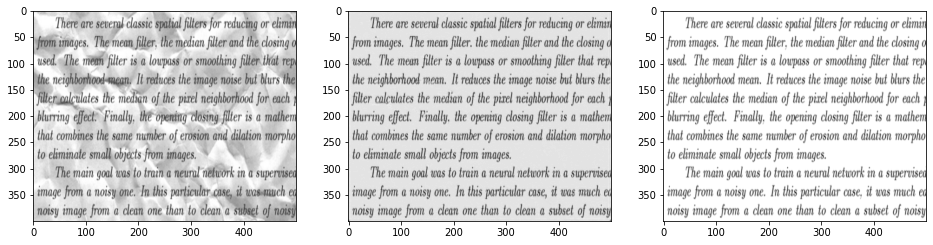

Epoch: 95 	Training Loss: 0.1293 	metric:0.2923


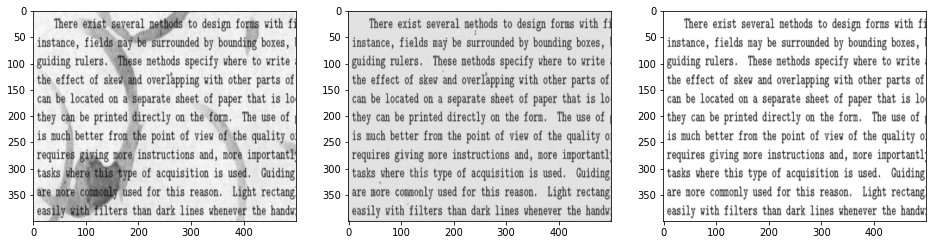

Epoch: 96 	Training Loss: 0.1252 	metric:0.2879


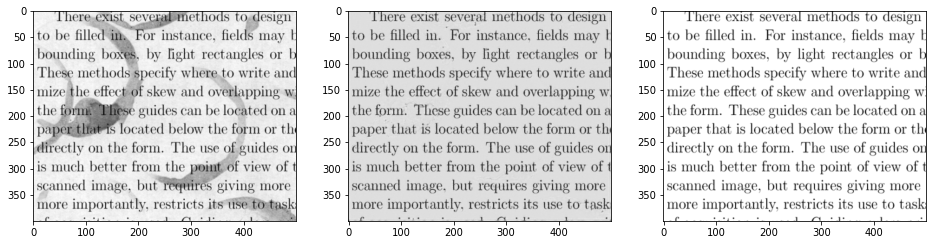

Epoch: 97 	Training Loss: 0.1212 	metric:0.2836


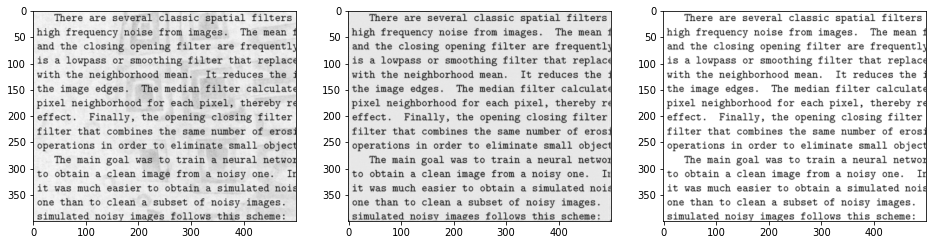

Epoch: 98 	Training Loss: 0.1174 	metric:0.2793


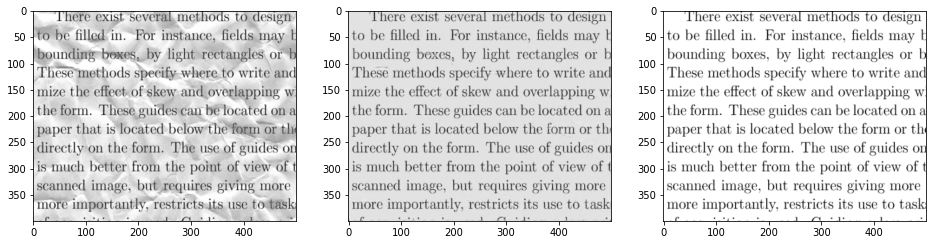

Epoch: 99 	Training Loss: 0.1136 	metric:0.275


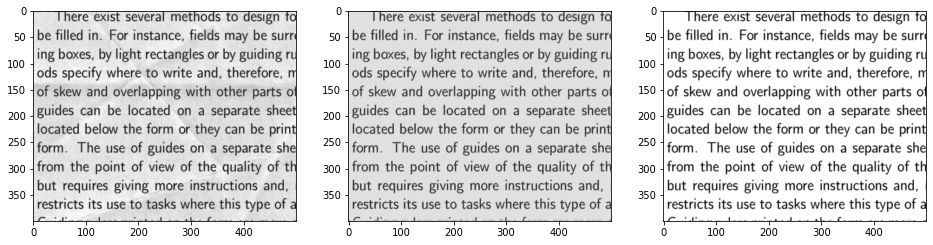

Epoch: 100 	Training Loss: 0.11 	metric:0.2708


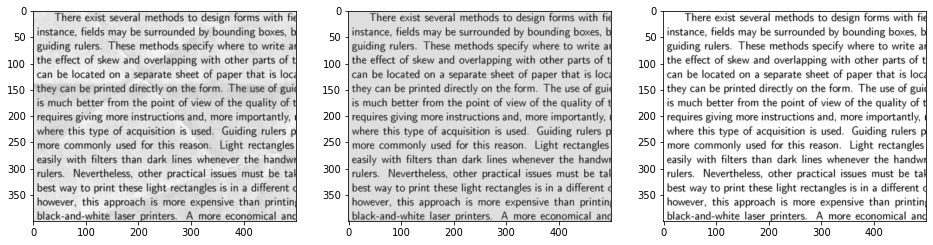

Epoch: 101 	Training Loss: 0.1063 	metric:0.2667


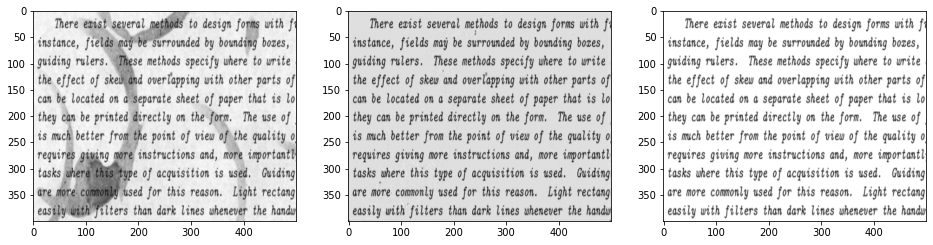

Epoch: 102 	Training Loss: 0.1029 	metric:0.2625


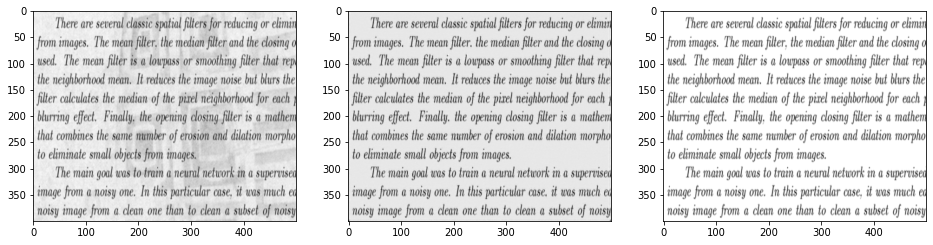

Epoch: 103 	Training Loss: 0.0995 	metric:0.2584


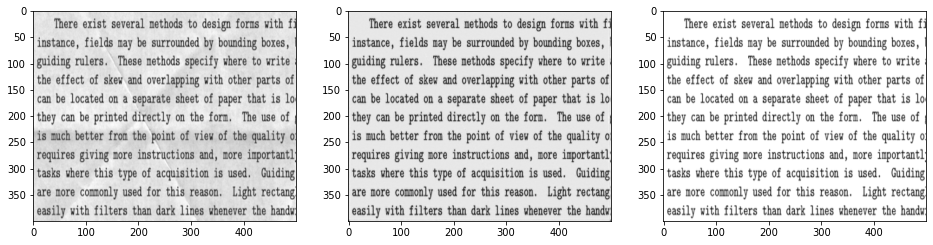

Epoch: 104 	Training Loss: 0.0962 	metric:0.2544


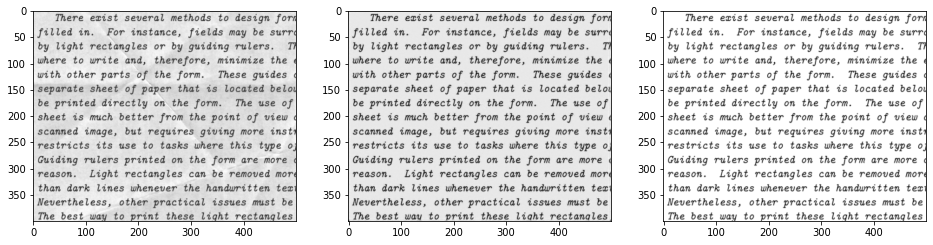

Epoch: 105 	Training Loss: 0.0929 	metric:0.2503


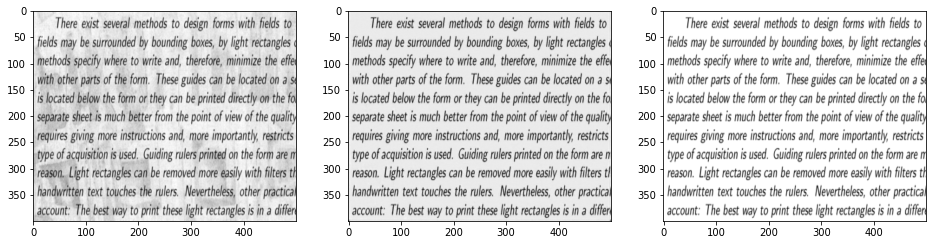

Epoch: 106 	Training Loss: 0.0898 	metric:0.2464


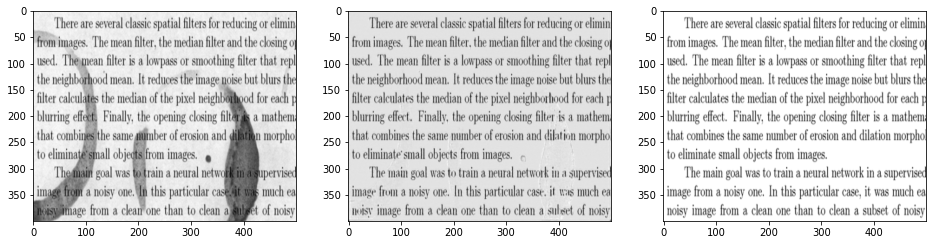

Epoch: 107 	Training Loss: 0.0868 	metric:0.2424


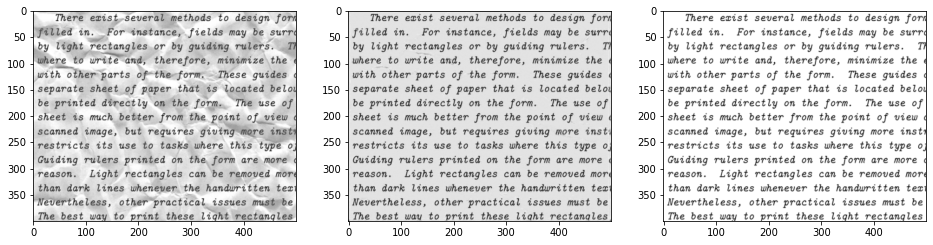

Epoch: 108 	Training Loss: 0.0839 	metric:0.2386


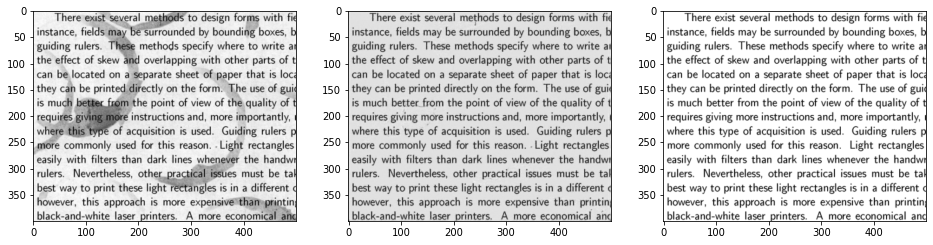

Epoch: 109 	Training Loss: 0.081 	metric:0.2347


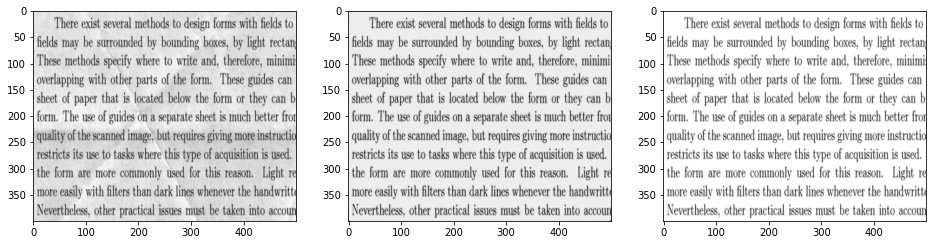

Epoch: 110 	Training Loss: 0.0782 	metric:0.2309


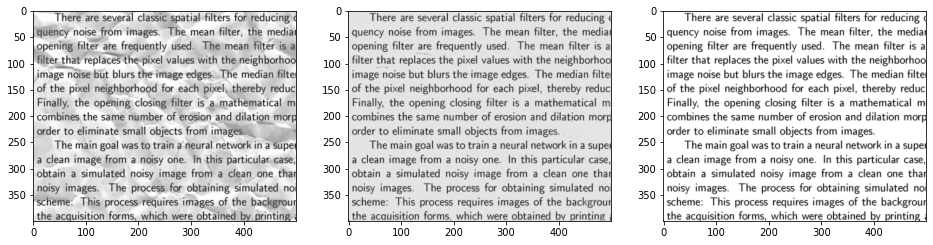

Epoch: 111 	Training Loss: 0.0755 	metric:0.2271


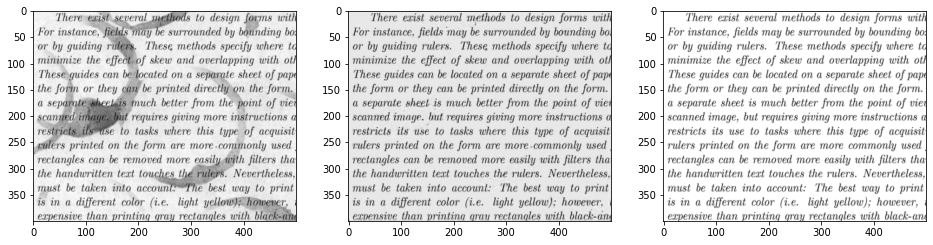

Epoch: 112 	Training Loss: 0.073 	metric:0.2234


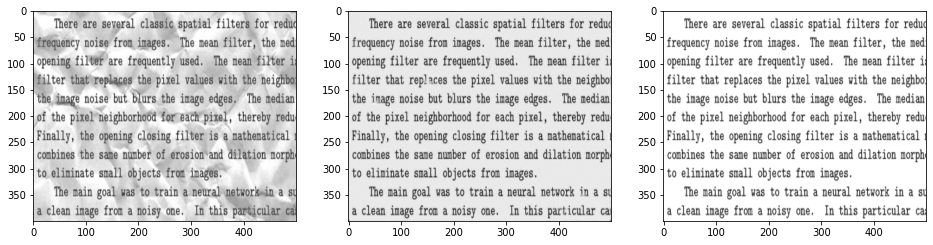

Epoch: 113 	Training Loss: 0.0705 	metric:0.2197


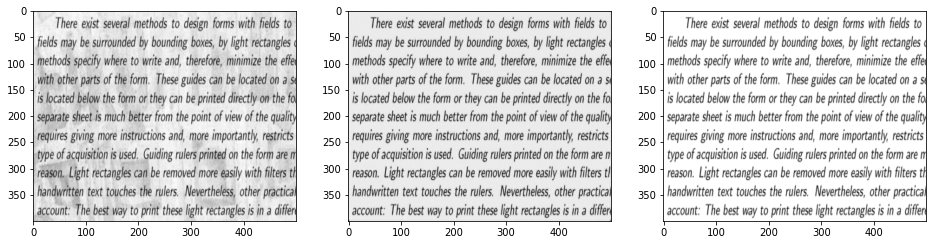

Epoch: 114 	Training Loss: 0.068 	metric:0.2161


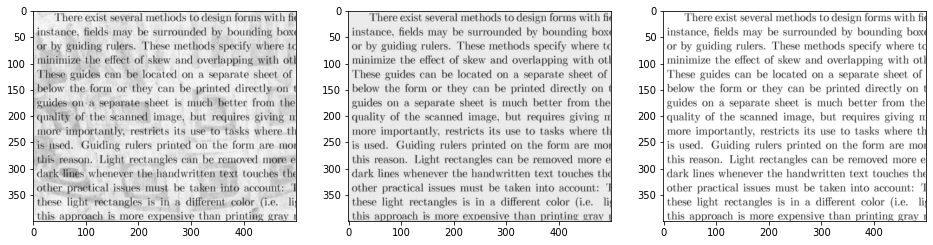

Epoch: 115 	Training Loss: 0.0657 	metric:0.2125


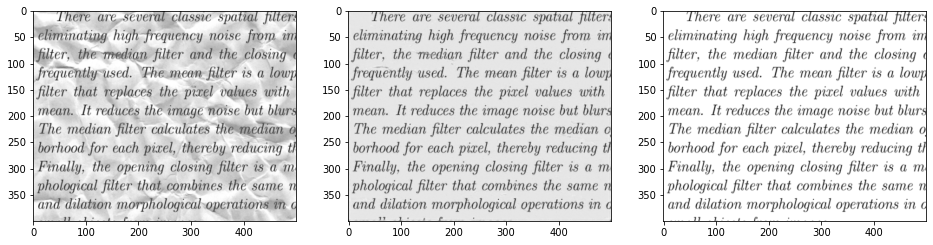

Epoch: 116 	Training Loss: 0.0633 	metric:0.2089


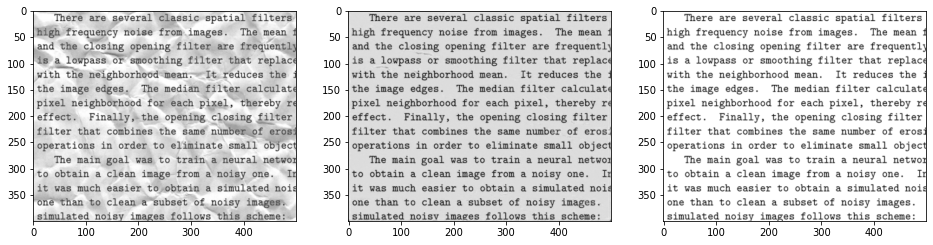

Epoch: 117 	Training Loss: 0.0612 	metric:0.2054


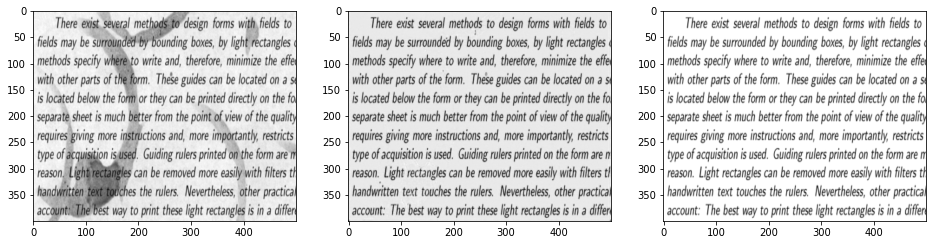

Epoch: 118 	Training Loss: 0.0591 	metric:0.2019


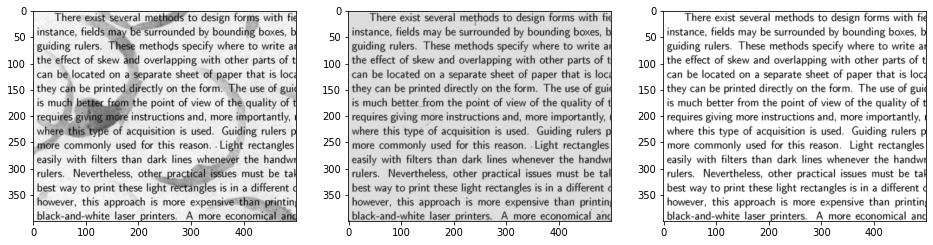

Epoch: 119 	Training Loss: 0.0569 	metric:0.1984


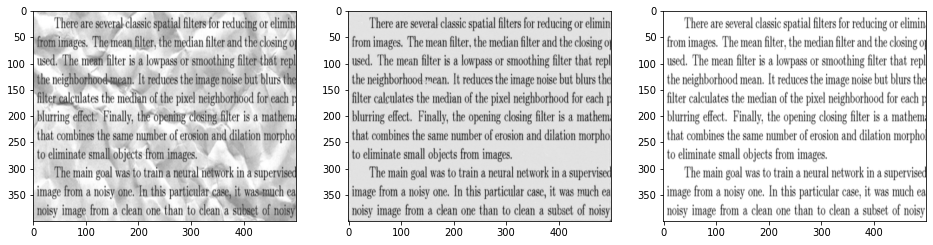

Epoch: 120 	Training Loss: 0.0548 	metric:0.195


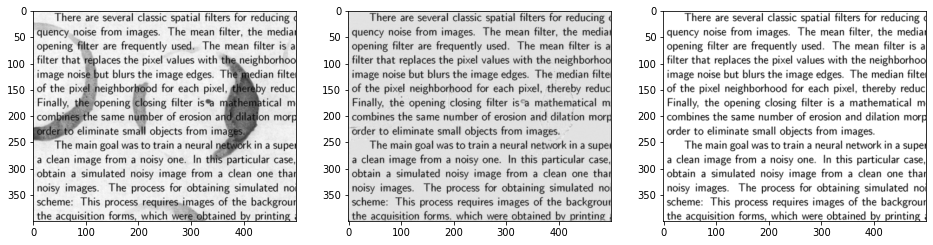

Epoch: 121 	Training Loss: 0.0529 	metric:0.1917


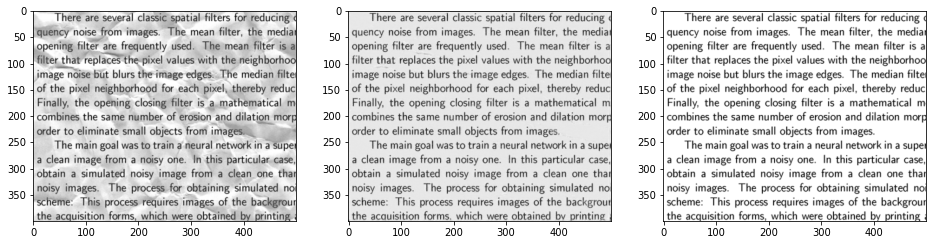

Epoch: 122 	Training Loss: 0.0509 	metric:0.1883


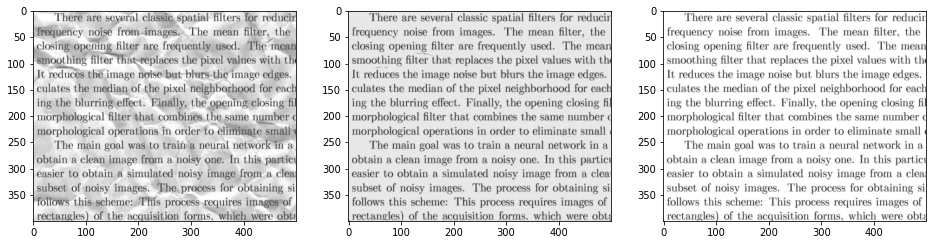

Epoch: 123 	Training Loss: 0.049 	metric:0.185


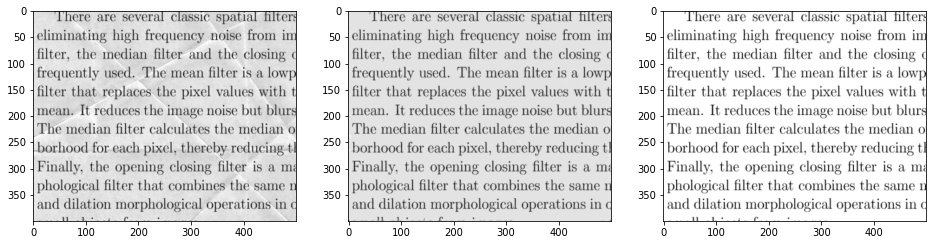

Epoch: 124 	Training Loss: 0.0473 	metric:0.1818


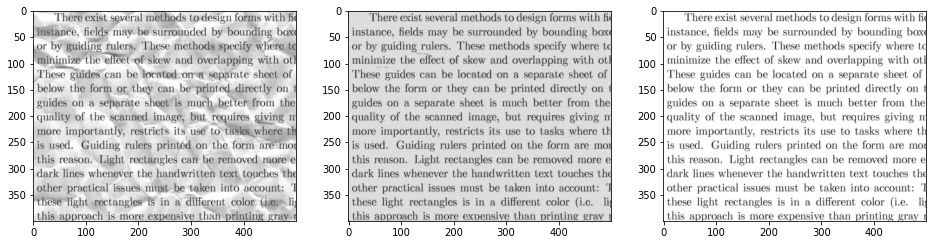

Epoch: 125 	Training Loss: 0.0455 	metric:0.1786


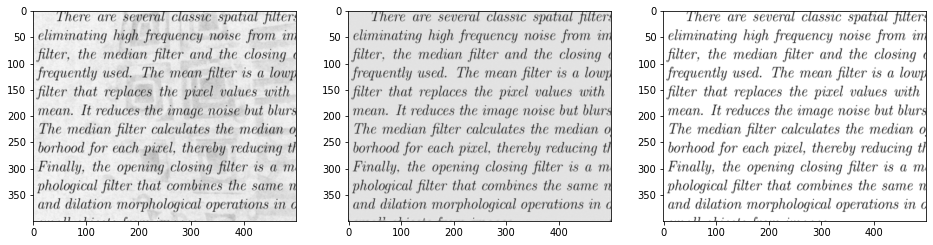

Epoch: 126 	Training Loss: 0.0438 	metric:0.1754


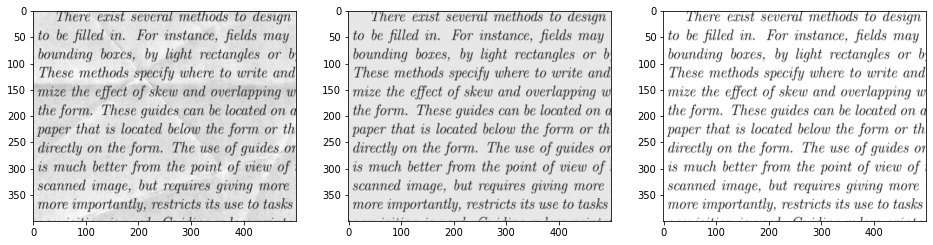

Epoch: 127 	Training Loss: 0.0424 	metric:0.1723


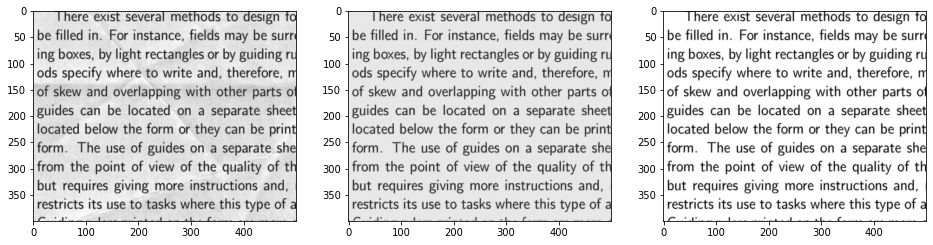

Epoch: 128 	Training Loss: 0.0406 	metric:0.1691


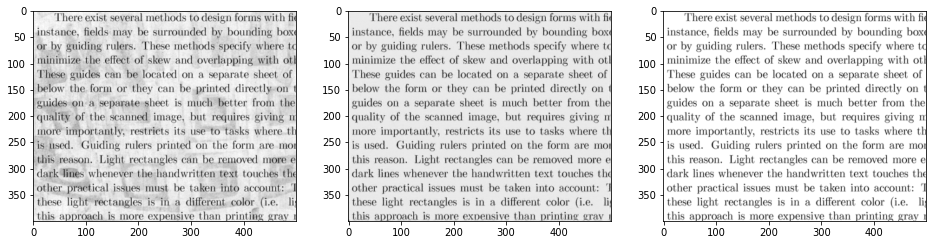

Epoch: 129 	Training Loss: 0.0391 	metric:0.1661


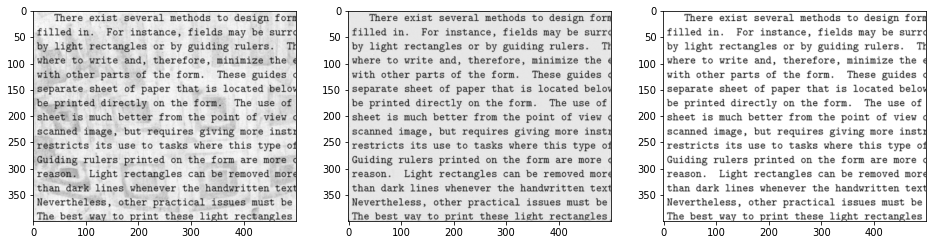

Epoch: 130 	Training Loss: 0.0376 	metric:0.1631


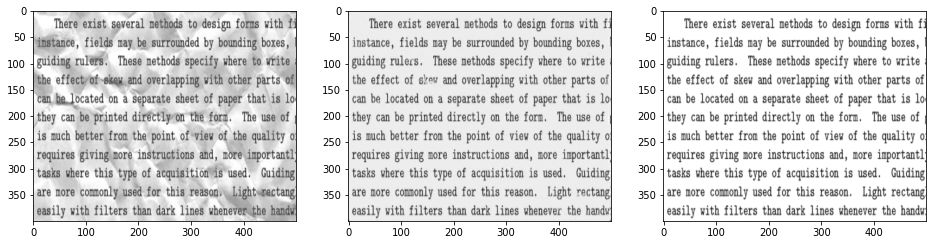

Epoch: 131 	Training Loss: 0.0362 	metric:0.1601


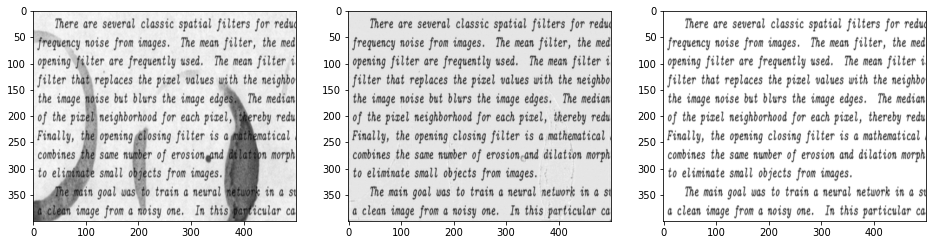

Epoch: 132 	Training Loss: 0.0348 	metric:0.1571


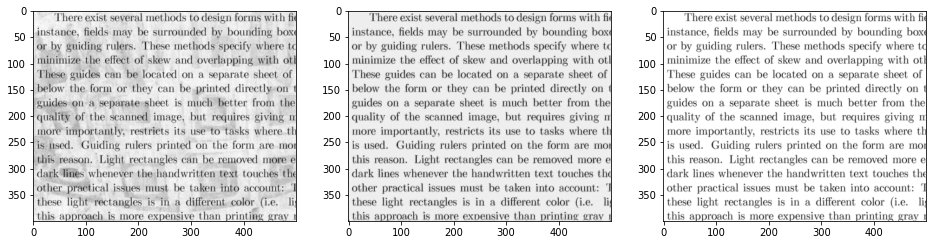

Epoch: 133 	Training Loss: 0.0336 	metric:0.1543


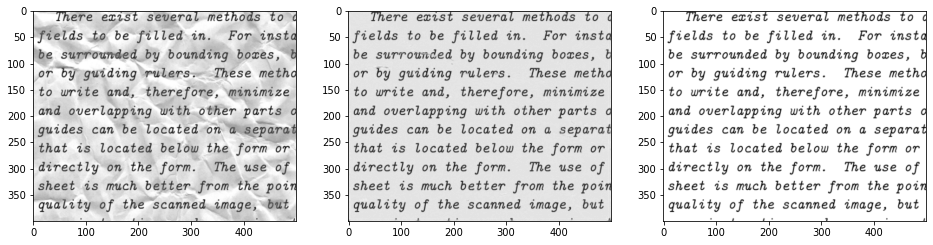

Epoch: 134 	Training Loss: 0.0322 	metric:0.1514


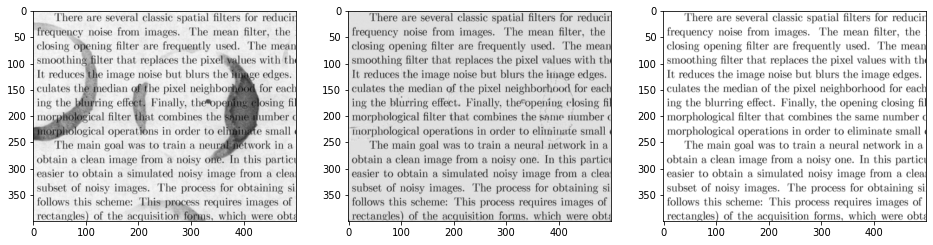

Epoch: 135 	Training Loss: 0.031 	metric:0.1486


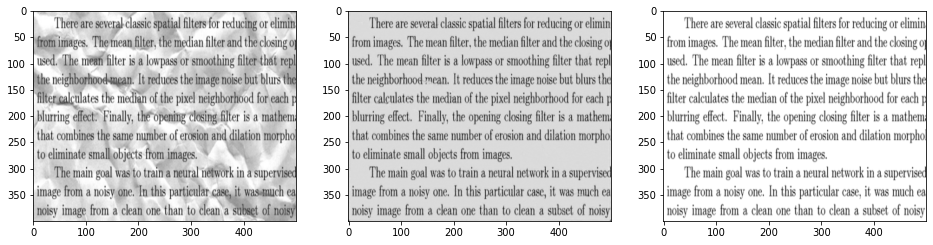

Epoch: 136 	Training Loss: 0.0298 	metric:0.1458


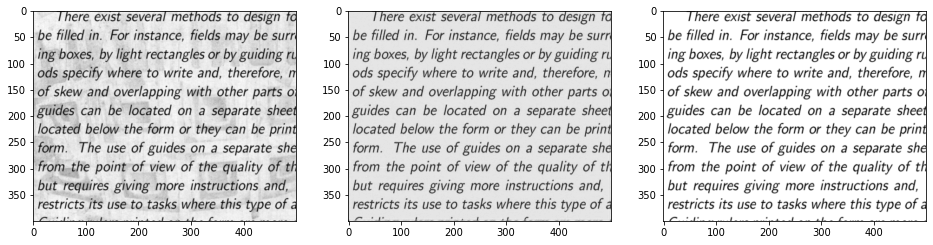

Epoch: 137 	Training Loss: 0.0286 	metric:0.143


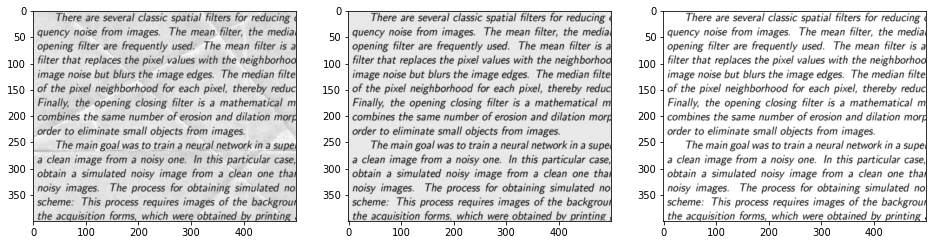

Epoch: 138 	Training Loss: 0.0275 	metric:0.1403


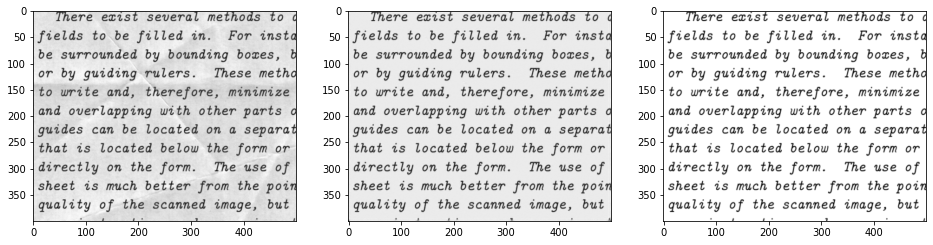

Epoch: 139 	Training Loss: 0.0265 	metric:0.1376


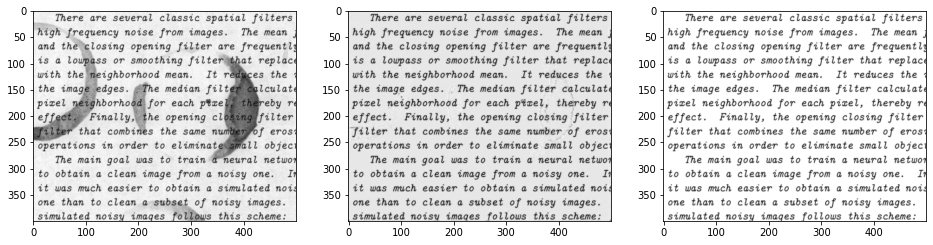

Epoch: 140 	Training Loss: 0.0254 	metric:0.135


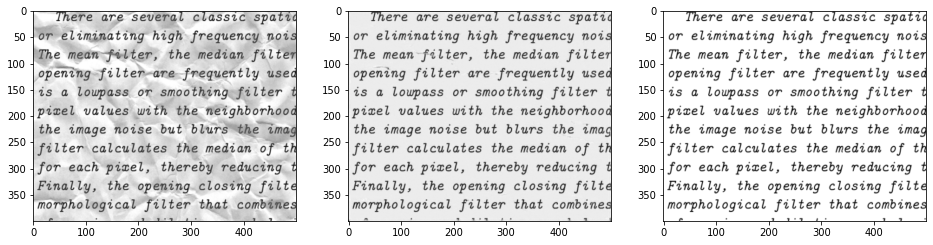

Epoch: 141 	Training Loss: 0.0244 	metric:0.1323


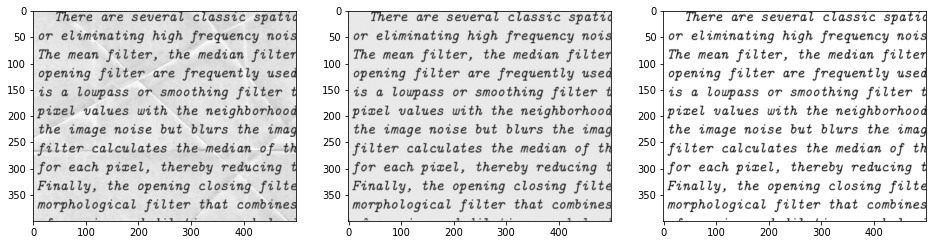

Epoch: 142 	Training Loss: 0.0234 	metric:0.1298


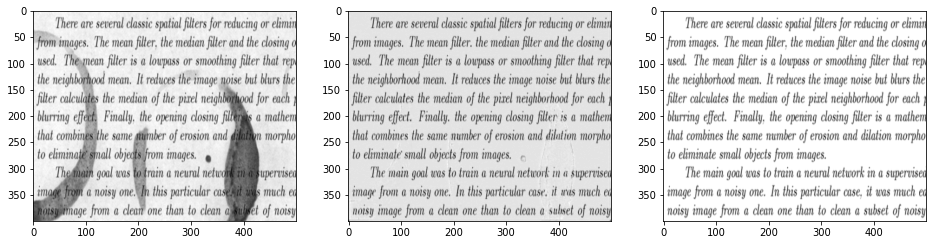

Epoch: 143 	Training Loss: 0.0225 	metric:0.1272


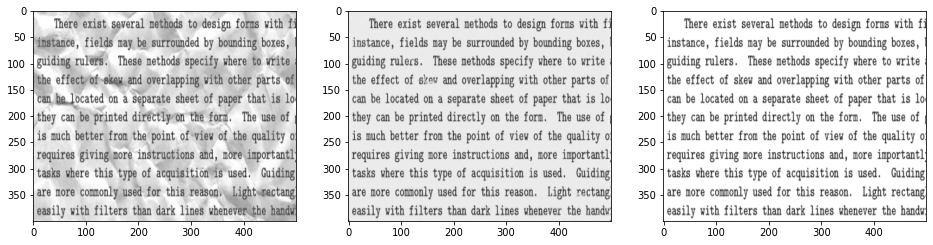

Epoch: 144 	Training Loss: 0.0216 	metric:0.1247


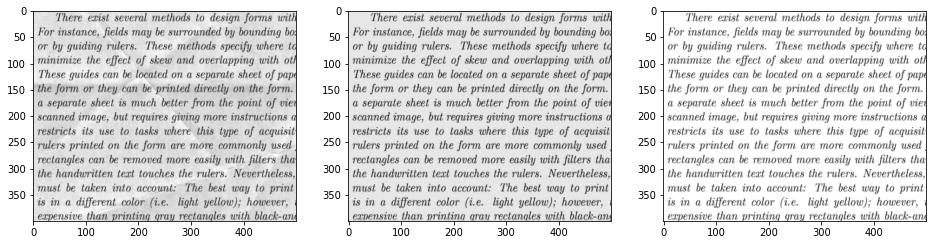

Epoch: 145 	Training Loss: 0.0207 	metric:0.1223


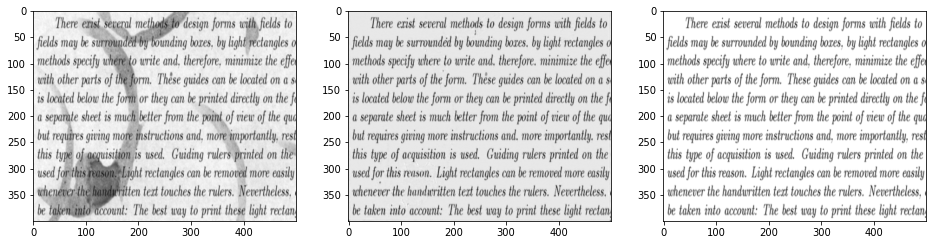

Epoch: 146 	Training Loss: 0.0199 	metric:0.1198


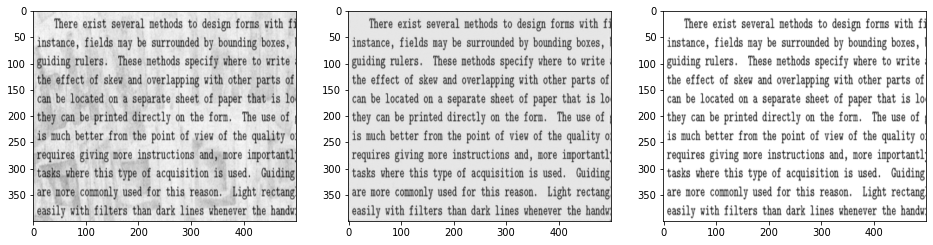

Epoch: 147 	Training Loss: 0.0191 	metric:0.1174


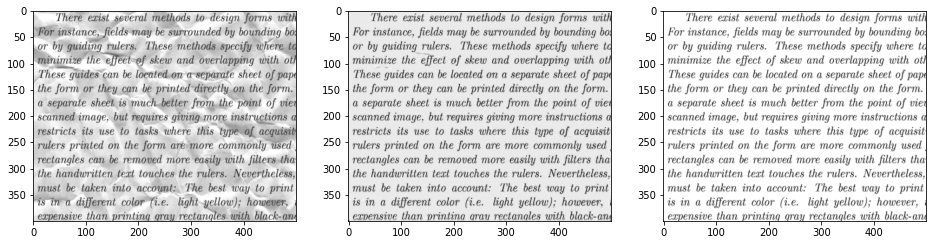

Epoch: 148 	Training Loss: 0.0183 	metric:0.1151


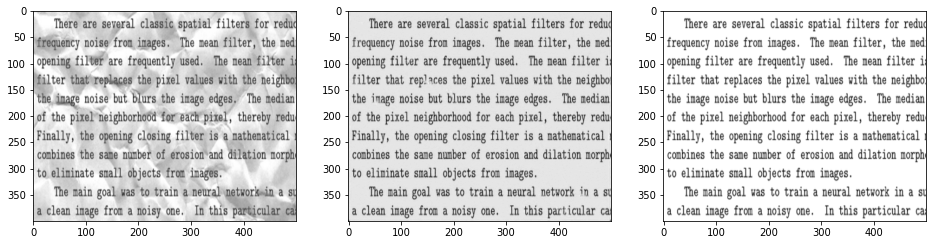

Epoch: 149 	Training Loss: 0.0176 	metric:0.1128


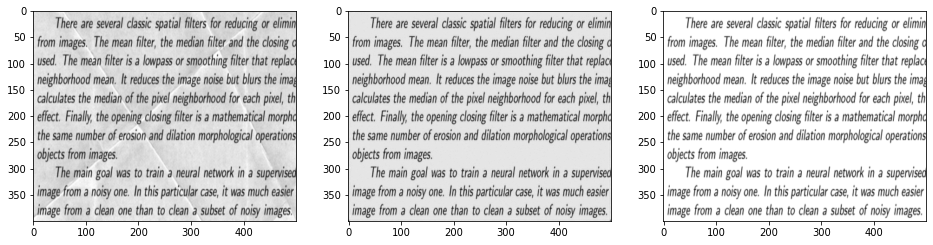

Epoch: 150 	Training Loss: 0.0169 	metric:0.1105


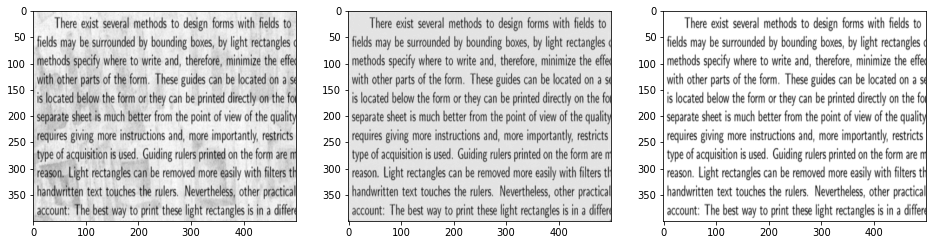

In [ ]:
criterion = torch.nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0009)
history = autoencoder_training(model, 150, optimizer, criterion)

In [ ]:
def get_plot(history):
    f, axes = plt.subplots(1, 2, figsize=(12, 5))
    axes[0].plot(history['train_loss'], label='Train loss')
    axes[0].legend()
    axes[0].set_title('Loss')
    
    axes[1].plot(history['train_metric'], label='Train metric')
    axes[1].legend()
    axes[1].set_title('Metric')

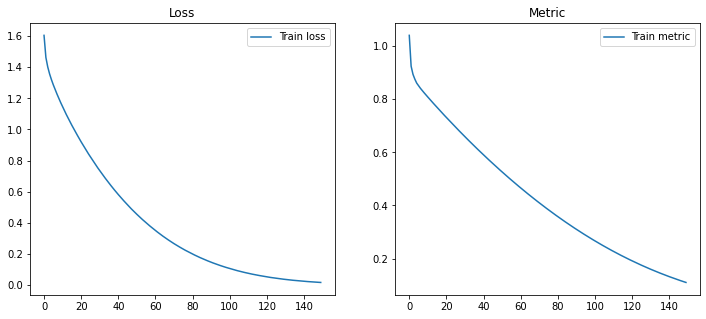

In [ ]:
get_plot(history)

In [ ]:
import numpy as np

In [ ]:
def get_model_result():
  img = read_image(os.path.join('test', '100.png'))/255
  img = model(img.unsqueeze(0).to(device))[0][0].detach().cpu().numpy()
  img = np.where(img > .88, 1, img)
  img = np.where(img < .2, 0, img)
  return img


In [ ]:
img_ser = get_model_result()
img = (read_image(os.path.join('test', '100.png'))/255)[0].detach().cpu().numpy()

In [ ]:
zeros = np.zeros(([10] + list(img.shape)))
for i, t in enumerate(np.linspace(0., 1., 10)):
  zeros[i] = img * (1-t) + img_ser * t

In [ ]:
for i in range(10):
  write_jpeg((torch.Tensor(zeros[i]).unsqueeze(0).detach().cpu() * 255).to(torch.uint8), f'gif/{i}.png')

In [ ]:
import imageio
import os
images = []
filenames = sorted(os.listdir('gif'))
print(filenames[:3])
for filename in filenames:
    if filename.endswith('png'):
        images.append(imageio.imread(f'gif/' + filename))
imageio.mimsave('gif/movie.gif', images, duration=0.2)

['.ipynb_checkpoints', '0.png', '1.png']


In [ ]:
torch.save(model.state_dict(), 'denoising-dirty-documents.pt')

In [ ]:
model.eval()

for noisy, clean in train_data:
    reconstructed = model(noisy.to(device))[0][0].detach().cpu().numpy()
    reconstructed = np.where(reconstructed > .88, 1, reconstructed)
    reconstructed = np.where(reconstructed < .2, 0, reconstructed)
    fig, ax = plt.subplots(1, 3, figsize=(21, 14))
    
    ax[0].imshow(noisy.detach().cpu().numpy()[0][0], cmap='gray')
    ax[1].imshow(reconstructed, cmap='gray')
    ax[2].imshow(clean.detach().cpu().numpy()[0][0], cmap='gray')

In [ ]:
# собираем названия тестовых файлов
test_files = os.listdir('test')
# переводим модель в режим валидации
model.eval()
# бежим по тестовым файлам
for fname in test_files:
    # читаем картинку (read_image и write_jpeg из torchvision.io)
    img = read_image(os.path.join('test', fname))/255
    # добавляем измерение батча
    batched_img = img.unsqueeze(0)
    # получаем предсказания модели и конвертируем в подходящий для write_jpeg формат
    model_out = (model(batched_img.to(device))[0].detach().cpu() * 255).to(torch.uint8)
    # записываем очищенную картинку
    write_jpeg(model_out, f'results/{fname}')